# Retinal Vessel

The retinal vessel segmentation is a binary image segmentation. 
```
DRIVE - 40 CFP images of 584*565 pixels
LES-AV - 22 CFP images of 1620 * 1440 pixels. We can use it to detect Glaucoma.
```

In [1]:
!pip install -U -q segmentation-models --user

from PIL import Image
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3' # suppresses all log messages except errors
os.environ["SM_FRAMEWORK"] = "tf.keras"# Tells the segmentation-models library to use TensorFlow's Keras framework (tf.keras) as the backend for building and training models.

import segmentation_models as sm
import matplotlib.pyplot as plt 
import tensorflow_io as tfio
import tensorflow as tf


root = '../input/retinal-vessel-segmentation'
exts = ('jpg', 'JPG', 'png', 'PNG', 'tif', 'gif', 'ppm')

Segmentation Models: using `tf.keras` framework.


# DRIVE

The dataset comes with pair of input retina image and target mask. Among all retina image, we will only use this dataset for a quick baseline. However, rest of the dataset can be replaces easily on this pipeline.


In [2]:
input_data = os.path.join(root, 'DRIVE/training/images')
images = sorted(
    [
        os.path.join(input_data, fname)
        for fname in os.listdir(input_data)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)


target_data = os.path.join(root, 'DRIVE/training/1st_manual')
masks = sorted(
    [
        os.path.join(target_data, fname)
        for fname in os.listdir(target_data) 
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

print("Number of samples:", len(images), len(masks))
for input_path, target_path in zip(images[:10], masks[:10]):
    print(input_path[-31:], "|", target_path[-34:])

Number of samples: 20 20
training/images/21_training.tif | training/1st_manual/21_manual1.gif
training/images/22_training.tif | training/1st_manual/22_manual1.gif
training/images/23_training.tif | training/1st_manual/23_manual1.gif
training/images/24_training.tif | training/1st_manual/24_manual1.gif
training/images/25_training.tif | training/1st_manual/25_manual1.gif
training/images/26_training.tif | training/1st_manual/26_manual1.gif
training/images/27_training.tif | training/1st_manual/27_manual1.gif
training/images/28_training.tif | training/1st_manual/28_manual1.gif
training/images/29_training.tif | training/1st_manual/29_manual1.gif
training/images/30_training.tif | training/1st_manual/30_manual1.gif


In [3]:
IMAGE_SIZE = 512
BATCH_SIZE = 12

def read_files(image_path, mask=False):
    image = tf.io.read_file(image_path)
    if mask: # if its a mask, dedcode the mask file into tensor, remove extra dimension and convert to grey-scale
        image = tf.io.decode_gif(image) # out: (1, h, w, 3)
        image = tf.squeeze(image) # out: (h, w, 3)
        image = tf.image.rgb_to_grayscale(image) # out: (h, w, 1)
        image = tf.divide(image, 128) # to normalize the values values in mask
        image.set_shape([None, None, 1]) # [height, weight, channel]
        image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
        image = tf.cast(image, tf.int32)
    else:
        image = tfio.experimental.image.decode_tiff(image) # out: (h, w, 4)
        image = image[:,:,:3] # out: (h, w, 3)
        image.set_shape([None, None, 3])
        image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
        image = image / 255.
    return image

def load_data(image_list, mask_list):
    image = read_files(image_list)
    mask  = read_files(mask_list, mask=True)
    return image, mask

def data_generator(image_list, mask_list):
    dataset = tf.data.Dataset.from_tensor_slices((image_list, mask_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=False)
    return dataset

train_dataset = data_generator(images, masks)
train_dataset

<BatchDataset shapes: ((None, 512, 512, 3), (None, 512, 512, 1)), types: (tf.float32, tf.int32)>

In [4]:
def visualize(**images):
    """PLot images in one row."""
    n = len(images) 
    plt.figure(figsize=(20, 20))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image, cmap='gray')
    plt.show()

(12, 512, 512, 3) (12, 512, 512, 1)
0 1
[0 1]


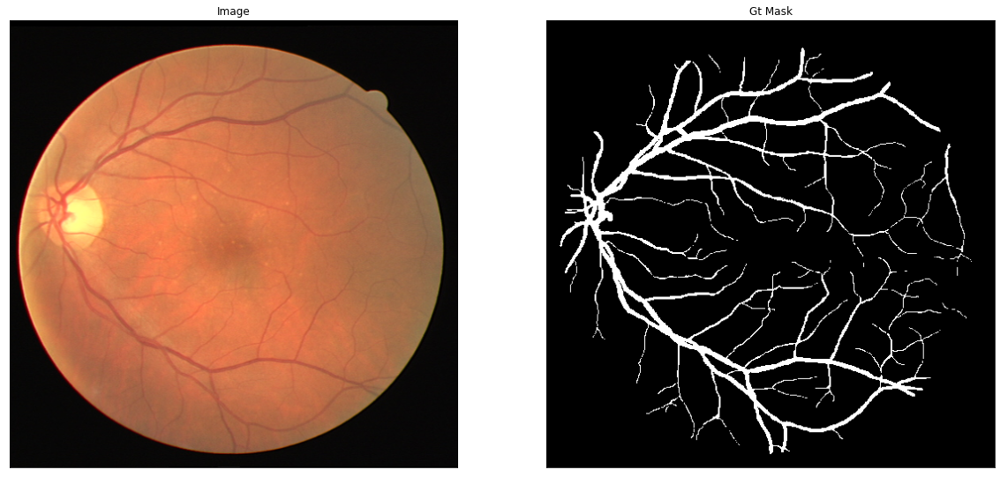

0 1
[0 1]


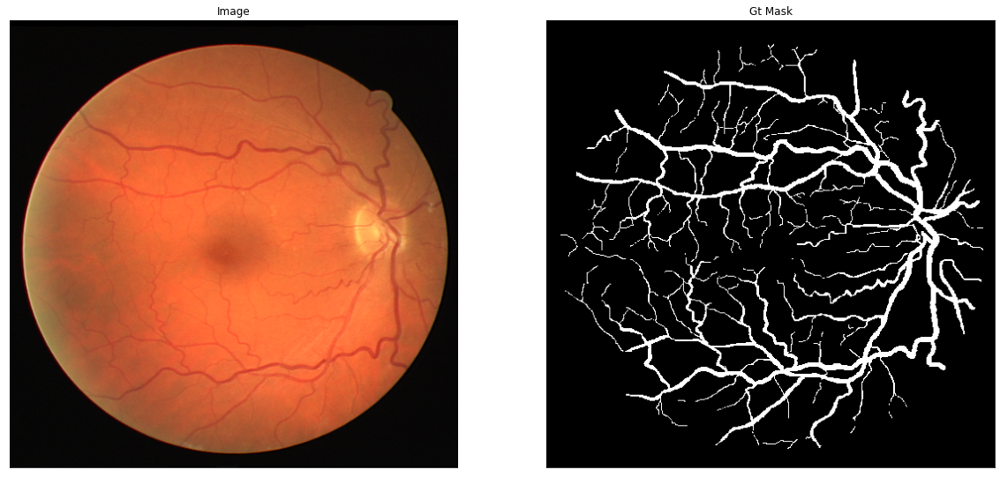

0 1
[0 1]


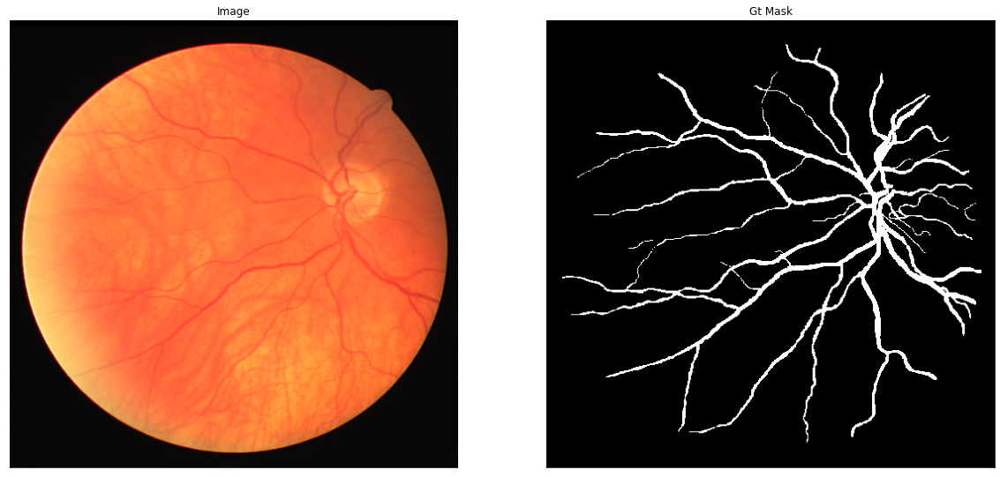

0 1
[0 1]


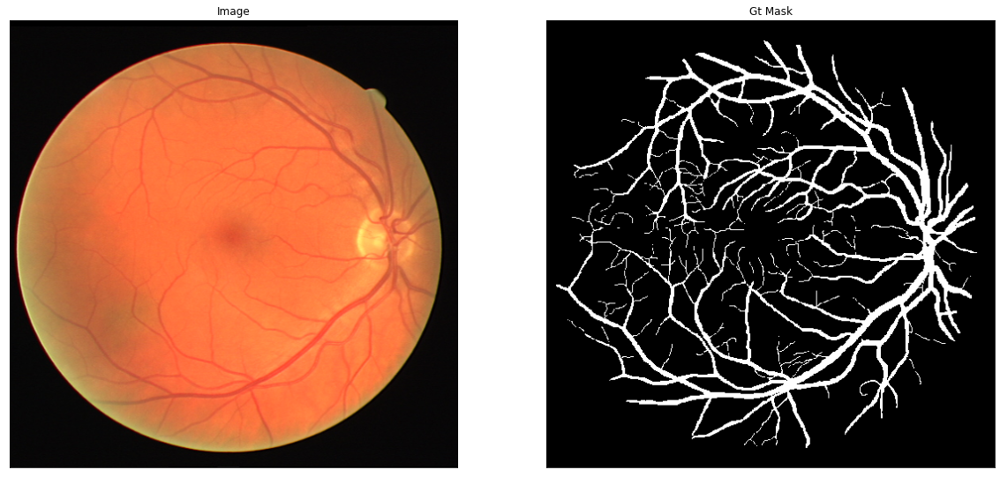

0 1
[0 1]


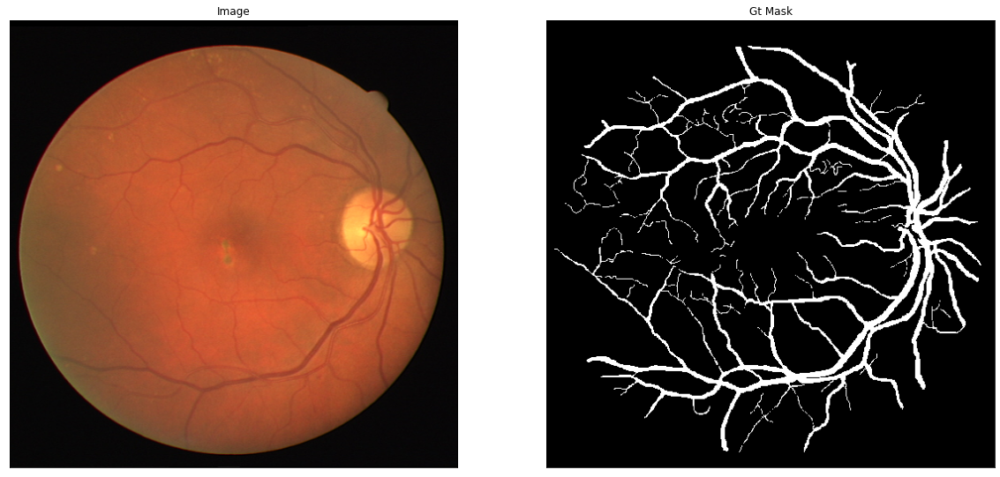

0 1
[0 1]


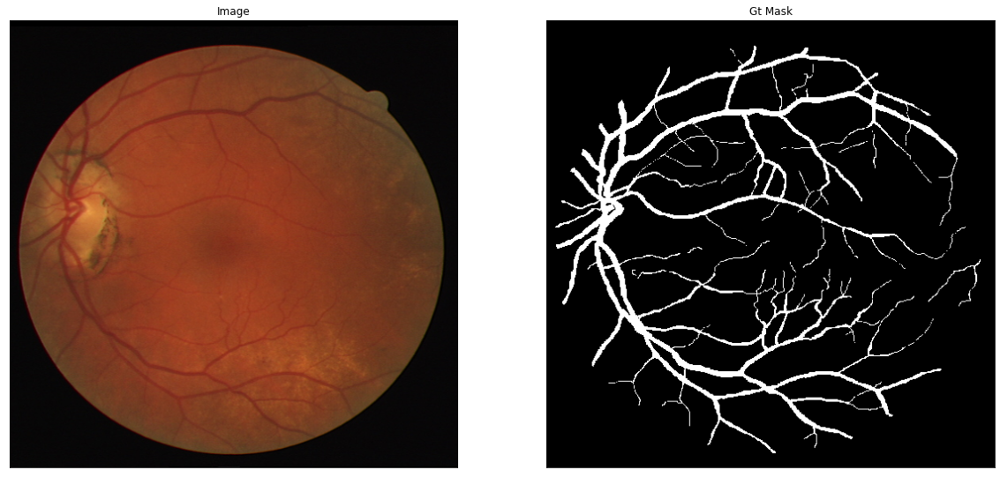

0 1
[0 1]


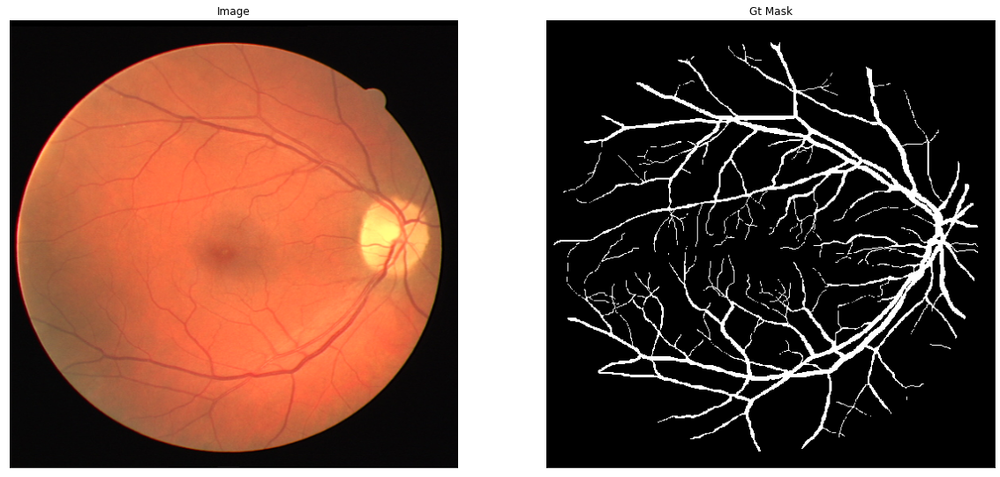

0 1
[0 1]


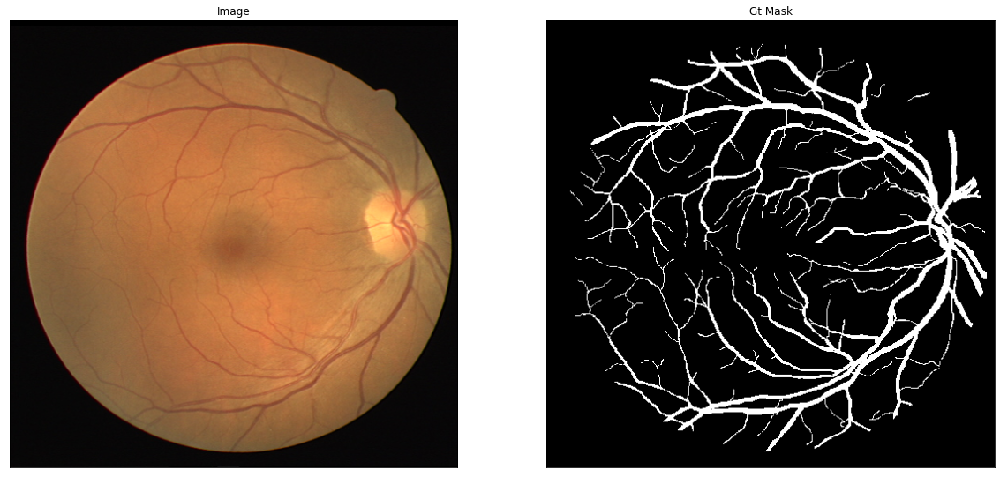

0 1
[0 1]


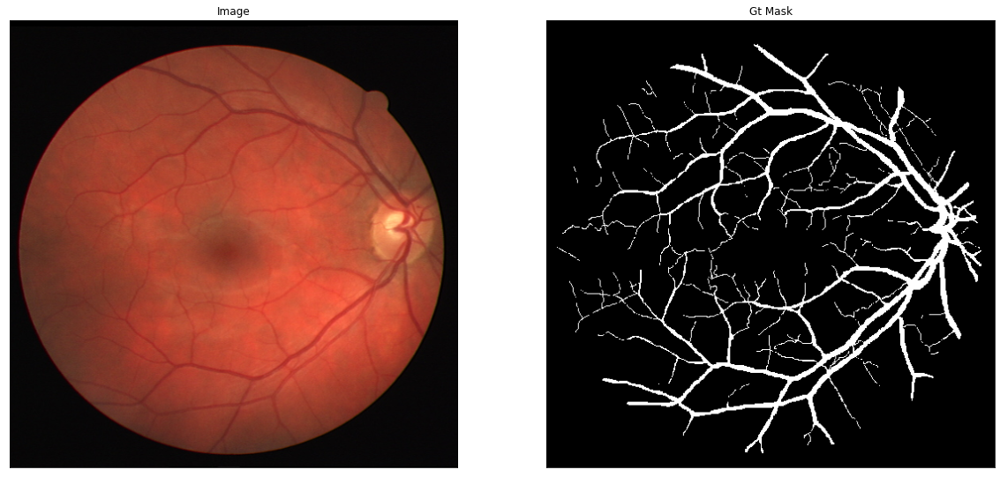

0 1
[0 1]


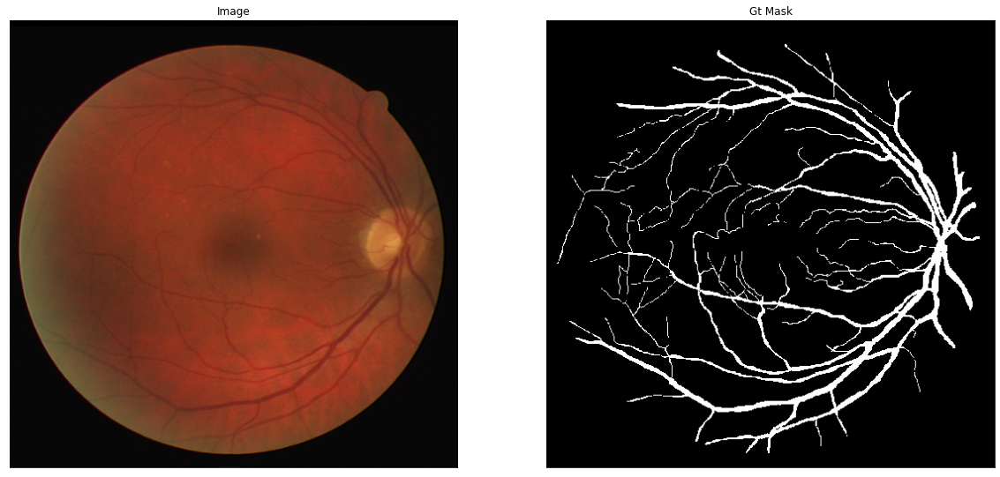

In [5]:
image, mask = next(iter(train_dataset.take(1))) 
print(image.shape, mask.shape)

for (img, msk) in zip(image[:10], mask[:10]):
    print(mask.numpy().min(), mask.numpy().max())
    print(np.unique(mask.numpy()))
    visualize(
        image=img.numpy(),
        gt_mask=msk.numpy(),
    )

# Model

In [6]:
from tensorflow import keras 

# Free up RAM in case the model definition cells were run multiple times
BACKBONE   = 'efficientnetb0'
n_classes  = 1 
activation = 'sigmoid' 
model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
model.summary(line_length=110)

16818176/16804768 [==============================] - 0s 0us/step
Model: "model"
______________________________________________________________________________________________________________
Layer (type)                        Output Shape            Param #      Connected to                         
input_1 (InputLayer)                [(None, None, None, 3)] 0                                                 
______________________________________________________________________________________________________________
stem_conv (Conv2D)                  (None, None, None, 32)  864          input_1[0][0]                        
______________________________________________________________________________________________________________
stem_bn (BatchNormalization)        (None, None, None, 32)  128          stem_conv[0][0]                      
______________________________________________________________________________________________________________
stem_activation (Activation)    

# Callback : Monitoring Training Progress

In [7]:
class DisplayCallback(keras.callbacks.Callback):
    def __init__(self, dataset, epoch_interval=5):
        self.dataset = dataset
        self.epoch_interval = epoch_interval
    
    def display(self, display_list, extra_title=''):
        plt.figure(figsize=(15, 15))
        title = ['Input Image', 'True Mask', 'Predicted Mask']

        if len(display_list) > len(title):
            title.append(extra_title)

        for i in range(len(display_list)):
            plt.subplot(1, len(display_list), i+1)
            plt.title(title[i])
            plt.imshow(display_list[i], cmap='gray')
            plt.axis('off')
        plt.show()
        
    def create_mask(self, pred_mask):
        pred_mask = (pred_mask > 0.5).astype("int32")
        return pred_mask[0]
    
    def show_predictions(self, dataset, num=1):
        for image, mask in dataset.take(num):
            pred_mask = model.predict(image)
            self.display([image[0], mask[0], self.create_mask(pred_mask)])
        
    def on_epoch_end(self, epoch, logs=None):
        if epoch and epoch % self.epoch_interval == 0:
            self.show_predictions(self.dataset)
            print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

# Compile and Fit

Epoch 1/400
2/2 [==============================] - 22s 3s/step - loss: 0.8908 - accuracy: 0.3290
Epoch 2/400
2/2 [==============================] - 1s 407ms/step - loss: 0.8615 - accuracy: 0.3436
Epoch 3/400
2/2 [==============================] - 1s 418ms/step - loss: 0.8354 - accuracy: 0.3683
Epoch 4/400
2/2 [==============================] - 1s 416ms/step - loss: 0.8106 - accuracy: 0.4036
Epoch 5/400
2/2 [==============================] - 1s 418ms/step - loss: 0.7876 - accuracy: 0.4452
Epoch 6/400
2/2 [==============================] - 1s 419ms/step - loss: 0.7663 - accuracy: 0.4871


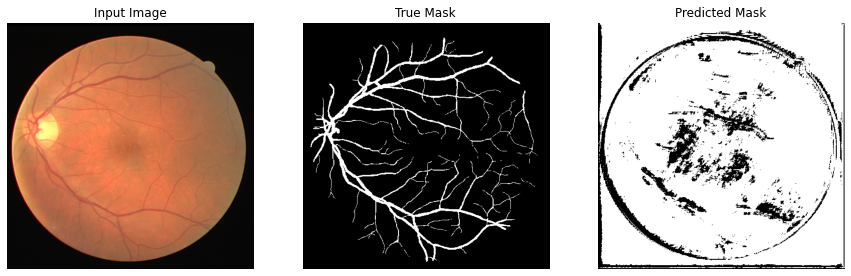


Sample Prediction after epoch 6

Epoch 7/400
2/2 [==============================] - 1s 419ms/step - loss: 0.7471 - accuracy: 0.5245
Epoch 8/400
2/2 [==============================] - 1s 404ms/step - loss: 0.7288 - accuracy: 0.5578
Epoch 9/400
2/2 [==============================] - 1s 418ms/step - loss: 0.7116 - accuracy: 0.5866
Epoch 10/400
2/2 [==============================] - 1s 418ms/step - loss: 0.6962 - accuracy: 0.6113
Epoch 11/400
2/2 [==============================] - 1s 418ms/step - loss: 0.6807 - accuracy: 0.6356


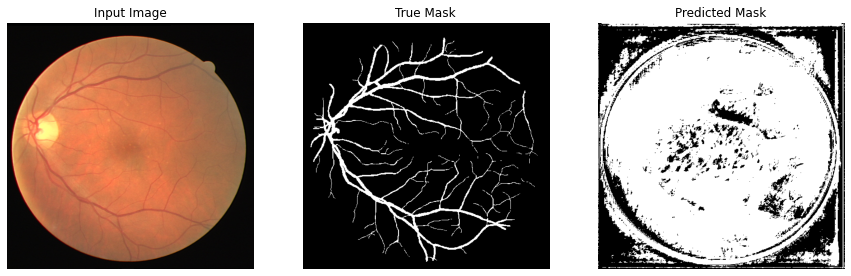


Sample Prediction after epoch 11

Epoch 12/400
2/2 [==============================] - 1s 418ms/step - loss: 0.6671 - accuracy: 0.6577
Epoch 13/400
2/2 [==============================] - 1s 417ms/step - loss: 0.6531 - accuracy: 0.6820
Epoch 14/400
2/2 [==============================] - 1s 420ms/step - loss: 0.6403 - accuracy: 0.7040
Epoch 15/400
2/2 [==============================] - 1s 418ms/step - loss: 0.6284 - accuracy: 0.7257
Epoch 16/400
2/2 [==============================] - 1s 416ms/step - loss: 0.6162 - accuracy: 0.7470


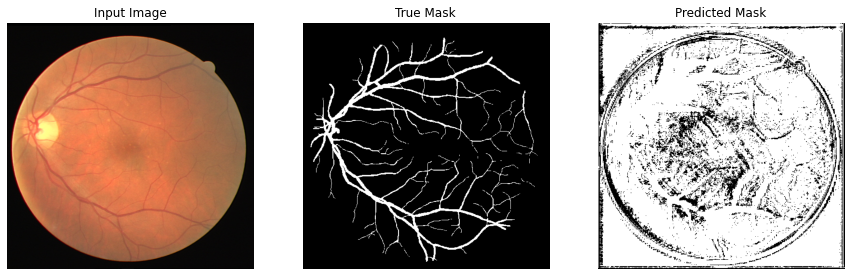


Sample Prediction after epoch 16

Epoch 17/400
2/2 [==============================] - 1s 418ms/step - loss: 0.6055 - accuracy: 0.7657
Epoch 18/400
2/2 [==============================] - 1s 418ms/step - loss: 0.5948 - accuracy: 0.7841
Epoch 19/400
2/2 [==============================] - 1s 418ms/step - loss: 0.5851 - accuracy: 0.8000
Epoch 20/400
2/2 [==============================] - 1s 418ms/step - loss: 0.5756 - accuracy: 0.8141
Epoch 21/400
2/2 [==============================] - 1s 412ms/step - loss: 0.5669 - accuracy: 0.8264


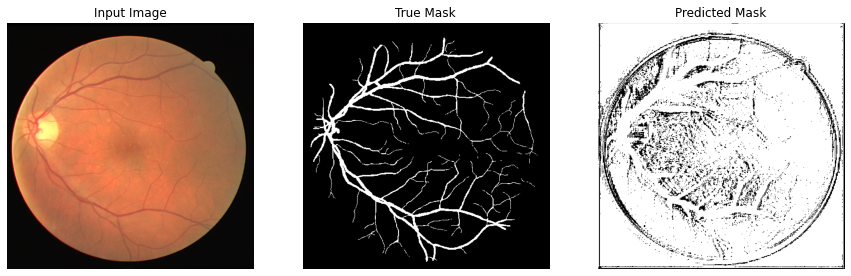


Sample Prediction after epoch 21

Epoch 22/400
2/2 [==============================] - 1s 416ms/step - loss: 0.5584 - accuracy: 0.8385
Epoch 23/400
2/2 [==============================] - 1s 418ms/step - loss: 0.5504 - accuracy: 0.8487
Epoch 24/400
2/2 [==============================] - 1s 405ms/step - loss: 0.5424 - accuracy: 0.8581
Epoch 25/400
2/2 [==============================] - 1s 418ms/step - loss: 0.5351 - accuracy: 0.8662
Epoch 26/400
2/2 [==============================] - 1s 417ms/step - loss: 0.5292 - accuracy: 0.8722


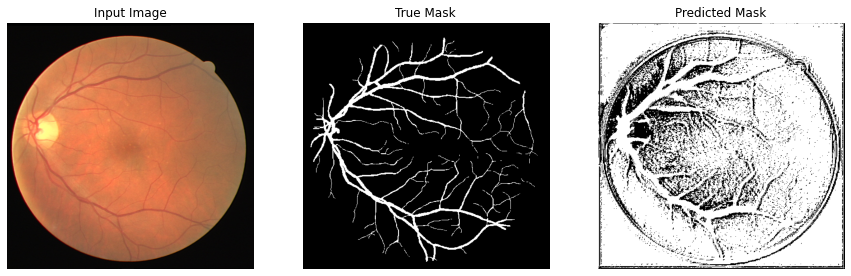


Sample Prediction after epoch 26

Epoch 27/400
2/2 [==============================] - 1s 420ms/step - loss: 0.5214 - accuracy: 0.8814
Epoch 28/400
2/2 [==============================] - 1s 416ms/step - loss: 0.5150 - accuracy: 0.8881
Epoch 29/400
2/2 [==============================] - 1s 418ms/step - loss: 0.5088 - accuracy: 0.8939
Epoch 30/400
2/2 [==============================] - 1s 417ms/step - loss: 0.5025 - accuracy: 0.8989
Epoch 31/400
2/2 [==============================] - 1s 417ms/step - loss: 0.4971 - accuracy: 0.9032


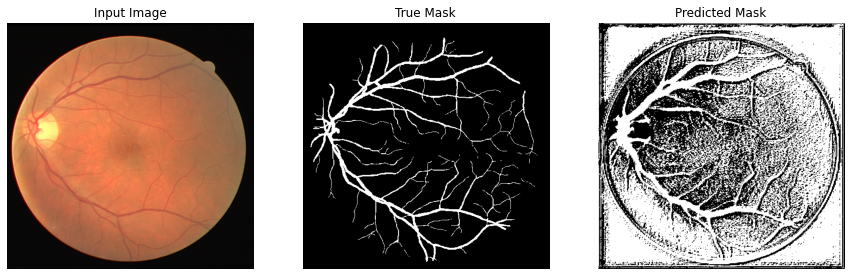


Sample Prediction after epoch 31

Epoch 32/400
2/2 [==============================] - 1s 416ms/step - loss: 0.4915 - accuracy: 0.9079
Epoch 33/400
2/2 [==============================] - 1s 416ms/step - loss: 0.4862 - accuracy: 0.9120
Epoch 34/400
2/2 [==============================] - 1s 418ms/step - loss: 0.4806 - accuracy: 0.9165
Epoch 35/400
2/2 [==============================] - 1s 417ms/step - loss: 0.4757 - accuracy: 0.9194
Epoch 36/400
2/2 [==============================] - 1s 418ms/step - loss: 0.4708 - accuracy: 0.9223


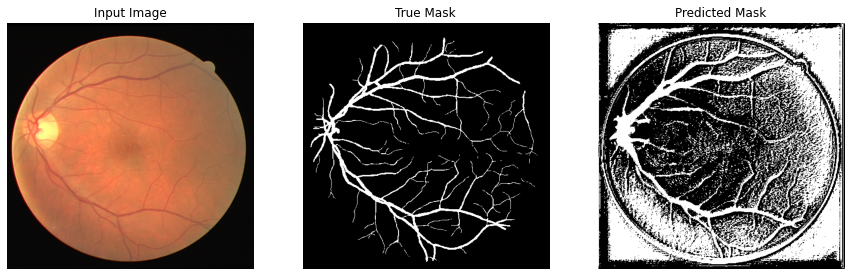


Sample Prediction after epoch 36

Epoch 37/400
2/2 [==============================] - 1s 417ms/step - loss: 0.4664 - accuracy: 0.9251
Epoch 38/400
2/2 [==============================] - 1s 416ms/step - loss: 0.4614 - accuracy: 0.9281
Epoch 39/400
2/2 [==============================] - 1s 417ms/step - loss: 0.4569 - accuracy: 0.9306
Epoch 40/400
2/2 [==============================] - 1s 407ms/step - loss: 0.4523 - accuracy: 0.9329
Epoch 41/400
2/2 [==============================] - 1s 419ms/step - loss: 0.4484 - accuracy: 0.9342


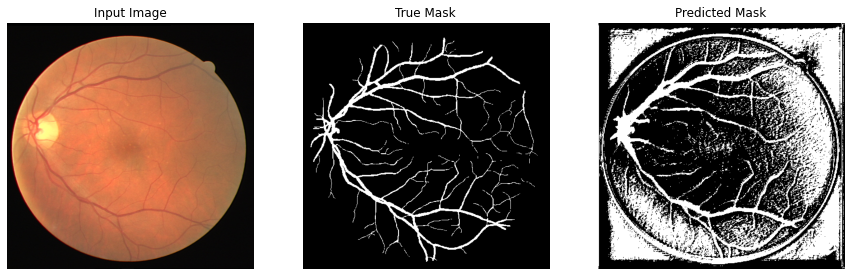


Sample Prediction after epoch 41

Epoch 42/400
2/2 [==============================] - 1s 420ms/step - loss: 0.4444 - accuracy: 0.9361
Epoch 43/400
2/2 [==============================] - 1s 419ms/step - loss: 0.4405 - accuracy: 0.9379
Epoch 44/400
2/2 [==============================] - 1s 418ms/step - loss: 0.4365 - accuracy: 0.9397
Epoch 45/400
2/2 [==============================] - 1s 405ms/step - loss: 0.4332 - accuracy: 0.9408
Epoch 46/400
2/2 [==============================] - 1s 421ms/step - loss: 0.4291 - accuracy: 0.9426


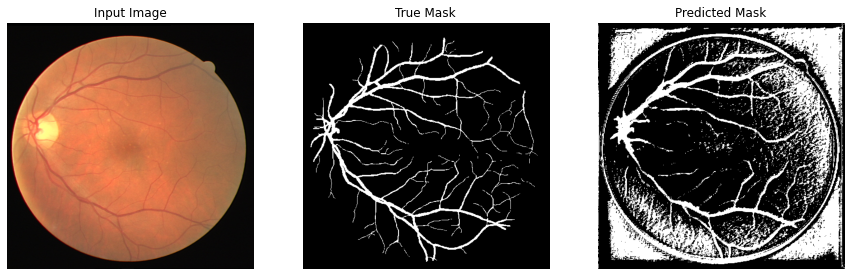


Sample Prediction after epoch 46

Epoch 47/400
2/2 [==============================] - 1s 418ms/step - loss: 0.4260 - accuracy: 0.9430
Epoch 48/400
2/2 [==============================] - 1s 417ms/step - loss: 0.4220 - accuracy: 0.9452
Epoch 49/400
2/2 [==============================] - 1s 418ms/step - loss: 0.4188 - accuracy: 0.9461
Epoch 50/400
2/2 [==============================] - 1s 418ms/step - loss: 0.4156 - accuracy: 0.9468
Epoch 51/400
2/2 [==============================] - 1s 421ms/step - loss: 0.4122 - accuracy: 0.9482


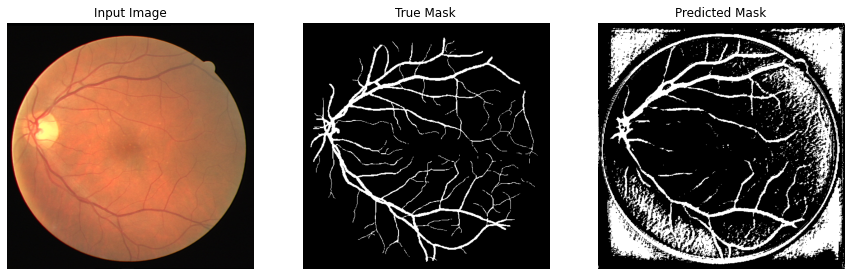


Sample Prediction after epoch 51

Epoch 52/400
2/2 [==============================] - 1s 418ms/step - loss: 0.4090 - accuracy: 0.9490
Epoch 53/400
2/2 [==============================] - 1s 418ms/step - loss: 0.4061 - accuracy: 0.9499
Epoch 54/400
2/2 [==============================] - 1s 417ms/step - loss: 0.4026 - accuracy: 0.9512
Epoch 55/400
2/2 [==============================] - 1s 406ms/step - loss: 0.3999 - accuracy: 0.9521
Epoch 56/400
2/2 [==============================] - 1s 418ms/step - loss: 0.3964 - accuracy: 0.9530


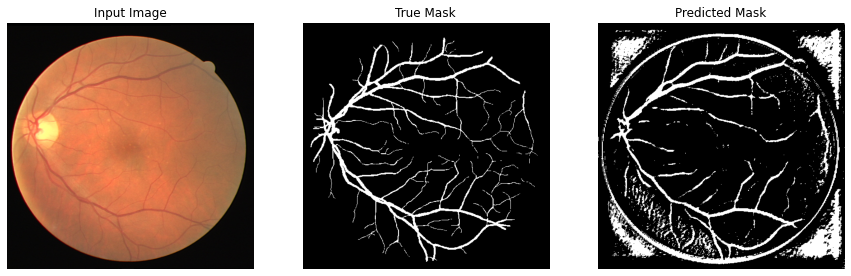


Sample Prediction after epoch 56

Epoch 57/400
2/2 [==============================] - 1s 417ms/step - loss: 0.3935 - accuracy: 0.9537
Epoch 58/400
2/2 [==============================] - 1s 418ms/step - loss: 0.3910 - accuracy: 0.9544
Epoch 59/400
2/2 [==============================] - 1s 418ms/step - loss: 0.3877 - accuracy: 0.9549
Epoch 60/400
2/2 [==============================] - 1s 416ms/step - loss: 0.3845 - accuracy: 0.9558
Epoch 61/400
2/2 [==============================] - 1s 417ms/step - loss: 0.3815 - accuracy: 0.9560


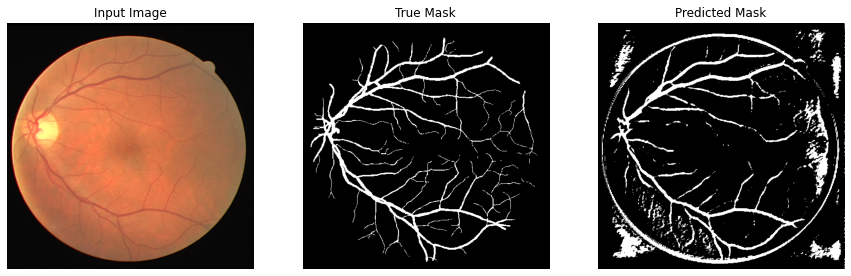


Sample Prediction after epoch 61

Epoch 62/400
2/2 [==============================] - 1s 417ms/step - loss: 0.3787 - accuracy: 0.9571
Epoch 63/400
2/2 [==============================] - 1s 418ms/step - loss: 0.3757 - accuracy: 0.9575
Epoch 64/400
2/2 [==============================] - 1s 419ms/step - loss: 0.3729 - accuracy: 0.9577
Epoch 65/400
2/2 [==============================] - 1s 416ms/step - loss: 0.3703 - accuracy: 0.9580
Epoch 66/400
2/2 [==============================] - 1s 418ms/step - loss: 0.3678 - accuracy: 0.9583


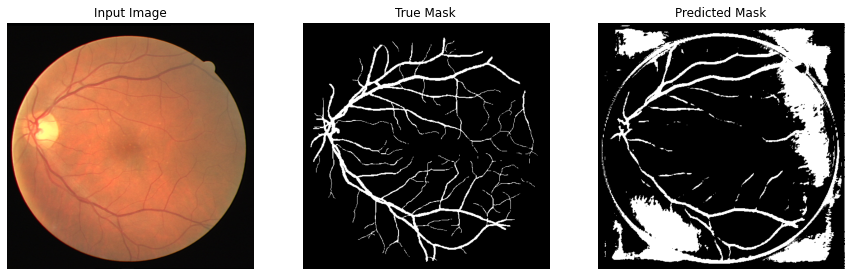


Sample Prediction after epoch 66

Epoch 67/400
2/2 [==============================] - 1s 404ms/step - loss: 0.3648 - accuracy: 0.9592
Epoch 68/400
2/2 [==============================] - 1s 418ms/step - loss: 0.3620 - accuracy: 0.9594
Epoch 69/400
2/2 [==============================] - 1s 420ms/step - loss: 0.3596 - accuracy: 0.9593
Epoch 70/400
2/2 [==============================] - 1s 417ms/step - loss: 0.3569 - accuracy: 0.9603
Epoch 71/400
2/2 [==============================] - 1s 416ms/step - loss: 0.3541 - accuracy: 0.9600


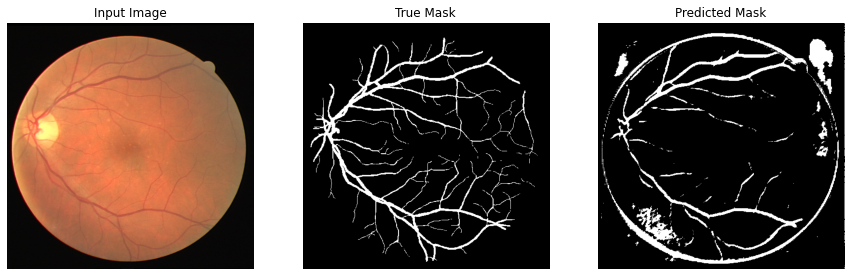


Sample Prediction after epoch 71

Epoch 72/400
2/2 [==============================] - 1s 417ms/step - loss: 0.3517 - accuracy: 0.9602
Epoch 73/400
2/2 [==============================] - 1s 404ms/step - loss: 0.3491 - accuracy: 0.9612
Epoch 74/400
2/2 [==============================] - 1s 418ms/step - loss: 0.3462 - accuracy: 0.9615
Epoch 75/400
2/2 [==============================] - 1s 418ms/step - loss: 0.3434 - accuracy: 0.9614
Epoch 76/400
2/2 [==============================] - 1s 417ms/step - loss: 0.3410 - accuracy: 0.9617


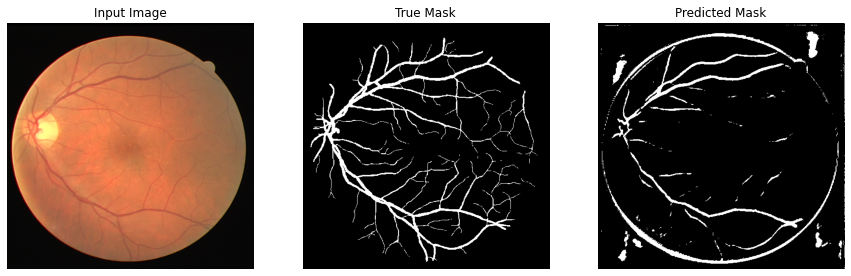


Sample Prediction after epoch 76

Epoch 77/400
2/2 [==============================] - 1s 418ms/step - loss: 0.3382 - accuracy: 0.9622
Epoch 78/400
2/2 [==============================] - 1s 403ms/step - loss: 0.3359 - accuracy: 0.9625
Epoch 79/400
2/2 [==============================] - 1s 426ms/step - loss: 0.3331 - accuracy: 0.9631
Epoch 80/400
2/2 [==============================] - 1s 419ms/step - loss: 0.3306 - accuracy: 0.9628
Epoch 81/400
2/2 [==============================] - 1s 418ms/step - loss: 0.3278 - accuracy: 0.9634


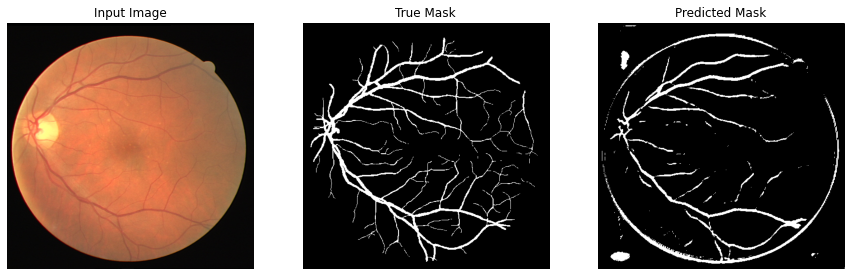


Sample Prediction after epoch 81

Epoch 82/400
2/2 [==============================] - 1s 403ms/step - loss: 0.3258 - accuracy: 0.9638
Epoch 83/400
2/2 [==============================] - 1s 417ms/step - loss: 0.3239 - accuracy: 0.9629
Epoch 84/400
2/2 [==============================] - 1s 417ms/step - loss: 0.3214 - accuracy: 0.9631
Epoch 85/400
2/2 [==============================] - 1s 417ms/step - loss: 0.3185 - accuracy: 0.9639
Epoch 86/400
2/2 [==============================] - 1s 418ms/step - loss: 0.3157 - accuracy: 0.9646


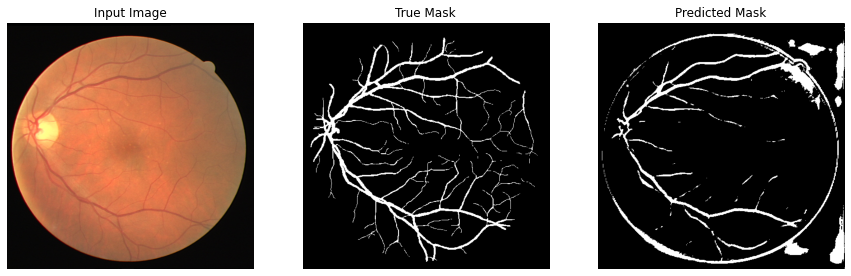


Sample Prediction after epoch 86

Epoch 87/400
2/2 [==============================] - 1s 417ms/step - loss: 0.3134 - accuracy: 0.9648
Epoch 88/400
2/2 [==============================] - 1s 418ms/step - loss: 0.3111 - accuracy: 0.9644
Epoch 89/400
2/2 [==============================] - 1s 417ms/step - loss: 0.3087 - accuracy: 0.9646
Epoch 90/400
2/2 [==============================] - 1s 417ms/step - loss: 0.3061 - accuracy: 0.9649
Epoch 91/400
2/2 [==============================] - 1s 405ms/step - loss: 0.3035 - accuracy: 0.9653


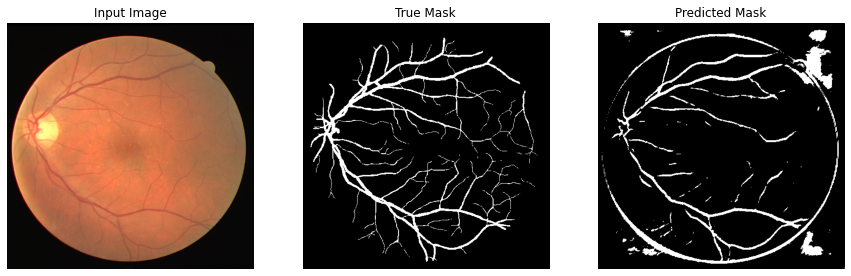


Sample Prediction after epoch 91

Epoch 92/400
2/2 [==============================] - 1s 409ms/step - loss: 0.3014 - accuracy: 0.9652
Epoch 93/400
2/2 [==============================] - 1s 421ms/step - loss: 0.2987 - accuracy: 0.9656
Epoch 94/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2964 - accuracy: 0.9658
Epoch 95/400
2/2 [==============================] - 1s 416ms/step - loss: 0.2943 - accuracy: 0.9659
Epoch 96/400
2/2 [==============================] - 1s 419ms/step - loss: 0.2920 - accuracy: 0.9661


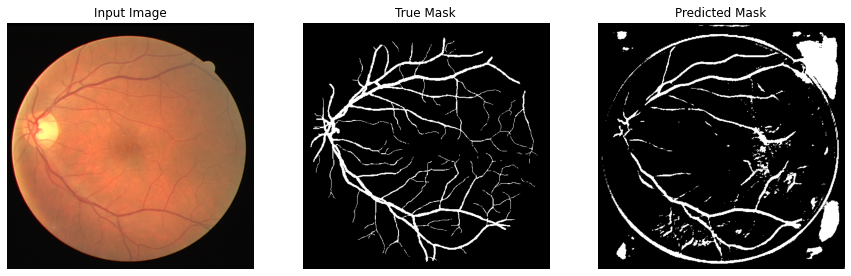


Sample Prediction after epoch 96

Epoch 97/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2897 - accuracy: 0.9661
Epoch 98/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2871 - accuracy: 0.9664
Epoch 99/400
2/2 [==============================] - 1s 404ms/step - loss: 0.2852 - accuracy: 0.9665
Epoch 100/400
2/2 [==============================] - 1s 420ms/step - loss: 0.2827 - accuracy: 0.9668
Epoch 101/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2802 - accuracy: 0.9671


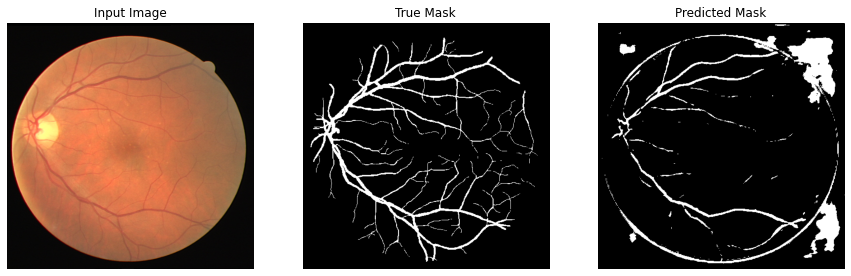


Sample Prediction after epoch 101

Epoch 102/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2785 - accuracy: 0.9670
Epoch 103/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2762 - accuracy: 0.9670
Epoch 104/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2746 - accuracy: 0.9669
Epoch 105/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2718 - accuracy: 0.9675
Epoch 106/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2704 - accuracy: 0.9672


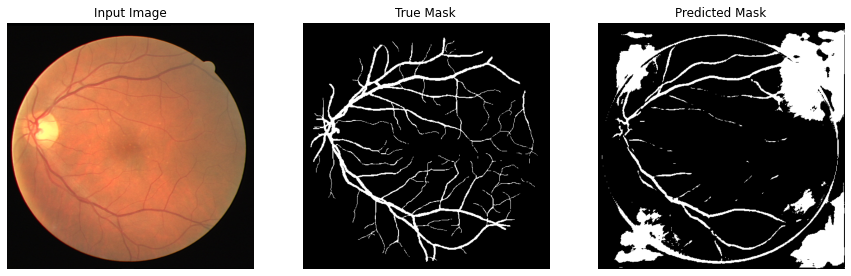


Sample Prediction after epoch 106

Epoch 107/400
2/2 [==============================] - 1s 405ms/step - loss: 0.2676 - accuracy: 0.9680
Epoch 108/400
2/2 [==============================] - 1s 407ms/step - loss: 0.2661 - accuracy: 0.9675
Epoch 109/400
2/2 [==============================] - 1s 405ms/step - loss: 0.2643 - accuracy: 0.9676
Epoch 110/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2617 - accuracy: 0.9681
Epoch 111/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2597 - accuracy: 0.9684


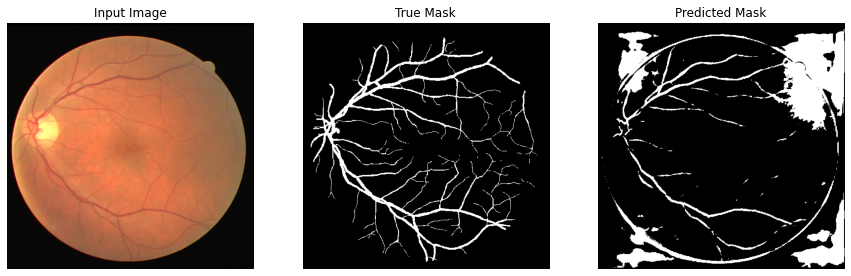


Sample Prediction after epoch 111

Epoch 112/400
2/2 [==============================] - 1s 419ms/step - loss: 0.2577 - accuracy: 0.9686
Epoch 113/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2567 - accuracy: 0.9681
Epoch 114/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2540 - accuracy: 0.9687
Epoch 115/400
2/2 [==============================] - 1s 420ms/step - loss: 0.2522 - accuracy: 0.9688
Epoch 116/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2503 - accuracy: 0.9690


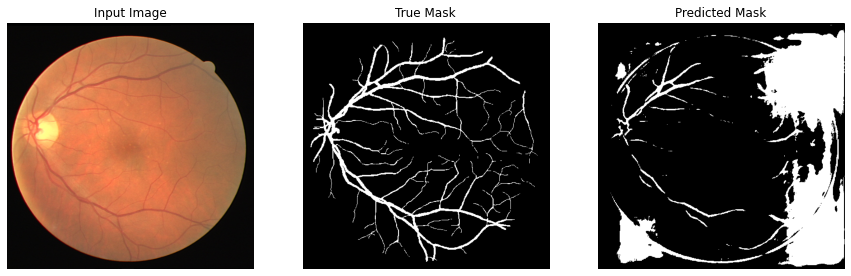


Sample Prediction after epoch 116

Epoch 117/400
2/2 [==============================] - 1s 419ms/step - loss: 0.2488 - accuracy: 0.9689
Epoch 118/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2471 - accuracy: 0.9691
Epoch 119/400
2/2 [==============================] - 1s 415ms/step - loss: 0.2453 - accuracy: 0.9693
Epoch 120/400
2/2 [==============================] - 1s 416ms/step - loss: 0.2435 - accuracy: 0.9694
Epoch 121/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2419 - accuracy: 0.9694


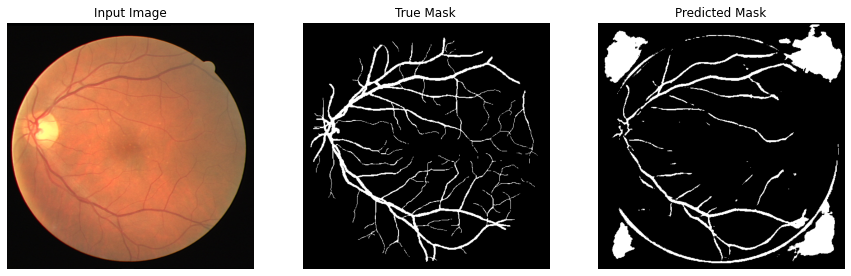


Sample Prediction after epoch 121

Epoch 122/400
2/2 [==============================] - 1s 416ms/step - loss: 0.2402 - accuracy: 0.9696
Epoch 123/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2391 - accuracy: 0.9694
Epoch 124/400
2/2 [==============================] - 1s 420ms/step - loss: 0.2367 - accuracy: 0.9700
Epoch 125/400
2/2 [==============================] - 1s 419ms/step - loss: 0.2351 - accuracy: 0.9701
Epoch 126/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2338 - accuracy: 0.9700


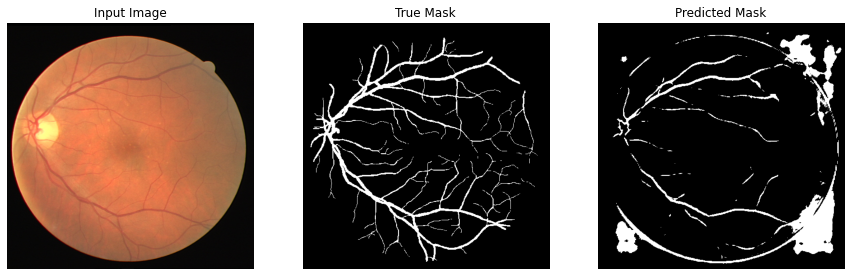


Sample Prediction after epoch 126

Epoch 127/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2320 - accuracy: 0.9704
Epoch 128/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2304 - accuracy: 0.9705
Epoch 129/400
2/2 [==============================] - 1s 404ms/step - loss: 0.2290 - accuracy: 0.9704
Epoch 130/400
2/2 [==============================] - 1s 406ms/step - loss: 0.2275 - accuracy: 0.9707
Epoch 131/400
2/2 [==============================] - 1s 416ms/step - loss: 0.2256 - accuracy: 0.9710


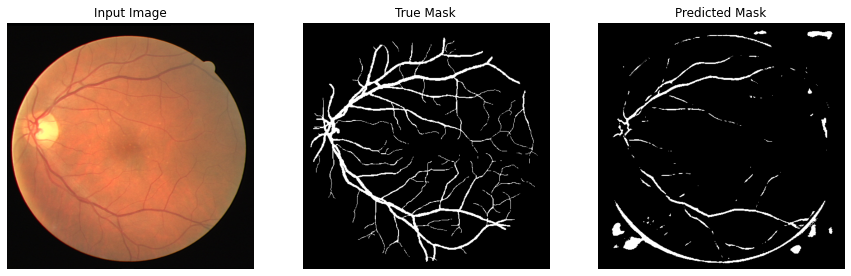


Sample Prediction after epoch 131

Epoch 132/400
2/2 [==============================] - 1s 419ms/step - loss: 0.2246 - accuracy: 0.9708
Epoch 133/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2235 - accuracy: 0.9707
Epoch 134/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2215 - accuracy: 0.9711
Epoch 135/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2204 - accuracy: 0.9711
Epoch 136/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2187 - accuracy: 0.9713


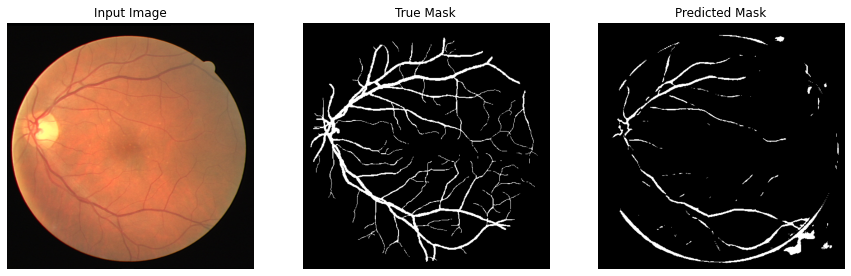


Sample Prediction after epoch 136

Epoch 137/400
2/2 [==============================] - 1s 420ms/step - loss: 0.2176 - accuracy: 0.9712
Epoch 138/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2157 - accuracy: 0.9716
Epoch 139/400
2/2 [==============================] - 1s 416ms/step - loss: 0.2142 - accuracy: 0.9718
Epoch 140/400
2/2 [==============================] - 1s 404ms/step - loss: 0.2133 - accuracy: 0.9717
Epoch 141/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2119 - accuracy: 0.9719


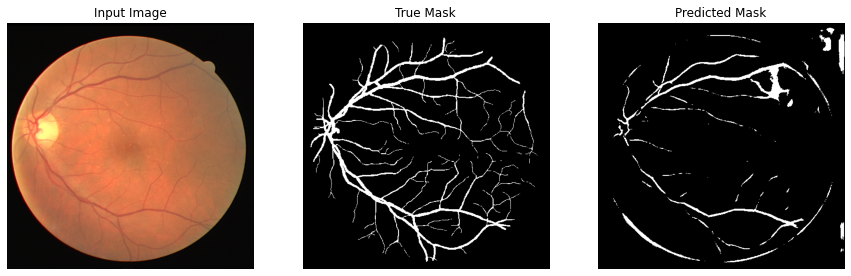


Sample Prediction after epoch 141

Epoch 142/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2102 - accuracy: 0.9722
Epoch 143/400
2/2 [==============================] - 1s 419ms/step - loss: 0.2094 - accuracy: 0.9719
Epoch 144/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2081 - accuracy: 0.9720
Epoch 145/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2064 - accuracy: 0.9725
Epoch 146/400
2/2 [==============================] - 1s 416ms/step - loss: 0.2055 - accuracy: 0.9723


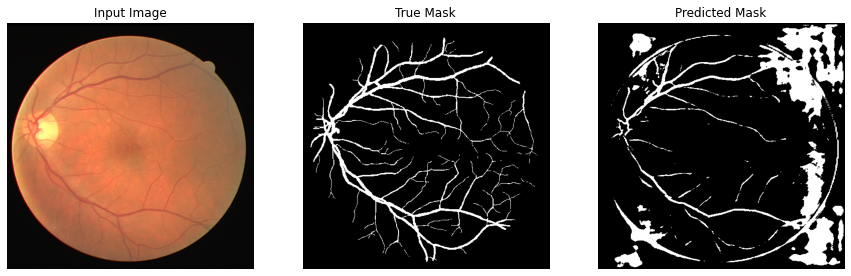


Sample Prediction after epoch 146

Epoch 147/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2039 - accuracy: 0.9725
Epoch 148/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2035 - accuracy: 0.9721
Epoch 149/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2013 - accuracy: 0.9728
Epoch 150/400
2/2 [==============================] - 1s 405ms/step - loss: 0.2003 - accuracy: 0.9727
Epoch 151/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1995 - accuracy: 0.9727


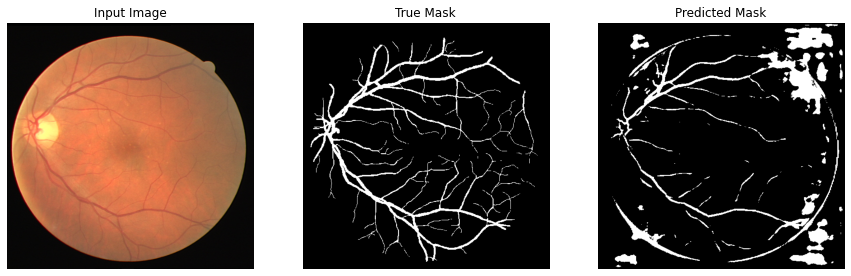


Sample Prediction after epoch 151

Epoch 152/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1979 - accuracy: 0.9731
Epoch 153/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1966 - accuracy: 0.9731
Epoch 154/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1954 - accuracy: 0.9732
Epoch 155/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1944 - accuracy: 0.9732
Epoch 156/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1929 - accuracy: 0.9735


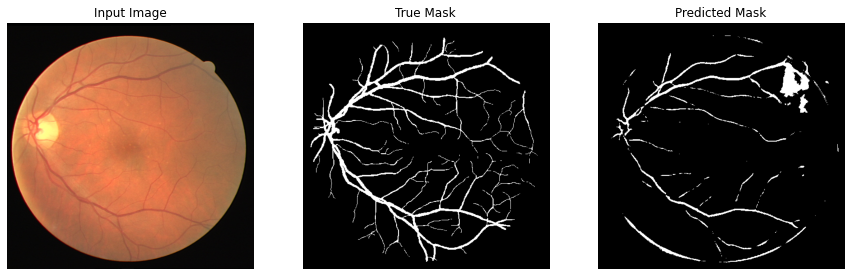


Sample Prediction after epoch 156

Epoch 157/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1917 - accuracy: 0.9737
Epoch 158/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1904 - accuracy: 0.9739
Epoch 159/400
2/2 [==============================] - 1s 402ms/step - loss: 0.1897 - accuracy: 0.9736
Epoch 160/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1887 - accuracy: 0.9738
Epoch 161/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1873 - accuracy: 0.9740


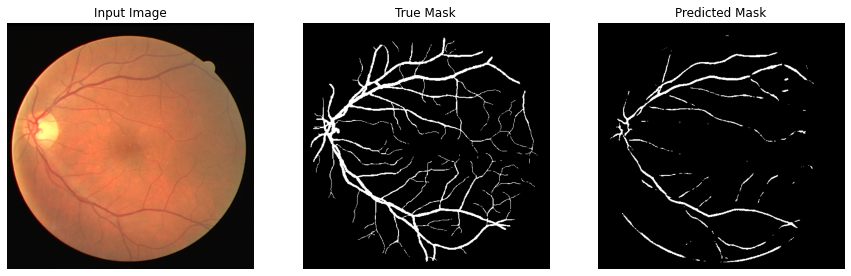


Sample Prediction after epoch 161

Epoch 162/400
2/2 [==============================] - 1s 403ms/step - loss: 0.1866 - accuracy: 0.9739
Epoch 163/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1852 - accuracy: 0.9741
Epoch 164/400
2/2 [==============================] - 1s 419ms/step - loss: 0.1838 - accuracy: 0.9745
Epoch 165/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1832 - accuracy: 0.9743
Epoch 166/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1817 - accuracy: 0.9747


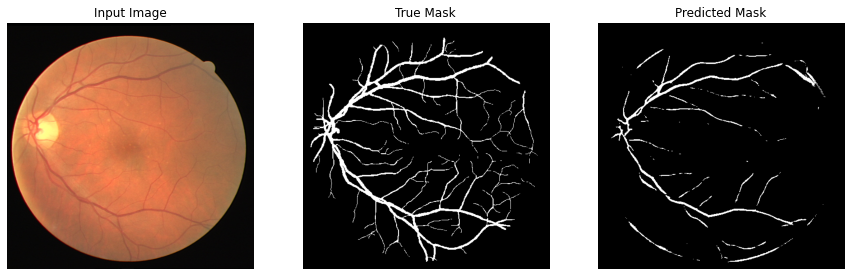


Sample Prediction after epoch 166

Epoch 167/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1817 - accuracy: 0.9742
Epoch 168/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1796 - accuracy: 0.9749
Epoch 169/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1789 - accuracy: 0.9747
Epoch 170/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1776 - accuracy: 0.9750
Epoch 171/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1764 - accuracy: 0.9754


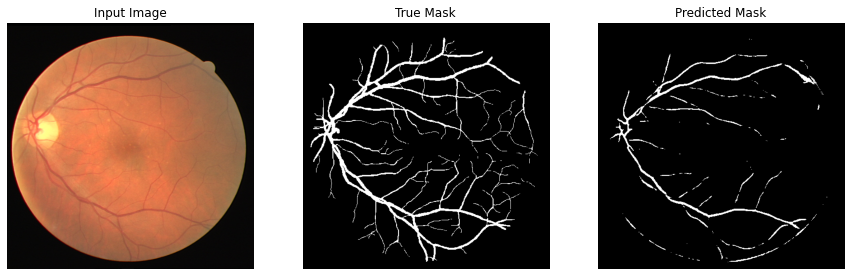


Sample Prediction after epoch 171

Epoch 172/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1762 - accuracy: 0.9749
Epoch 173/400
2/2 [==============================] - 1s 419ms/step - loss: 0.1749 - accuracy: 0.9752
Epoch 174/400
2/2 [==============================] - 1s 403ms/step - loss: 0.1742 - accuracy: 0.9749
Epoch 175/400
2/2 [==============================] - 1s 407ms/step - loss: 0.1732 - accuracy: 0.9750
Epoch 176/400
2/2 [==============================] - 1s 402ms/step - loss: 0.1726 - accuracy: 0.9751


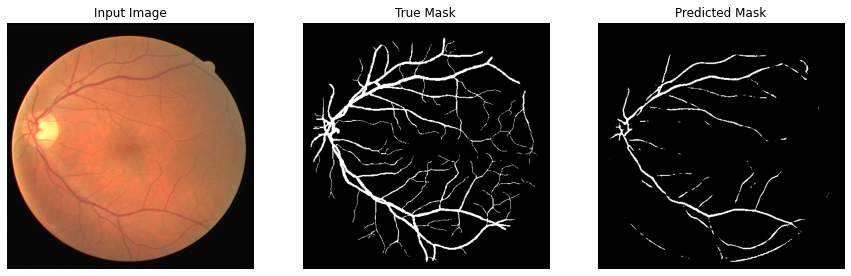


Sample Prediction after epoch 176

Epoch 177/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1709 - accuracy: 0.9756
Epoch 178/400
2/2 [==============================] - 1s 407ms/step - loss: 0.1700 - accuracy: 0.9757
Epoch 179/400
2/2 [==============================] - 1s 419ms/step - loss: 0.1695 - accuracy: 0.9756
Epoch 180/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1682 - accuracy: 0.9758
Epoch 181/400
2/2 [==============================] - 1s 405ms/step - loss: 0.1672 - accuracy: 0.9760


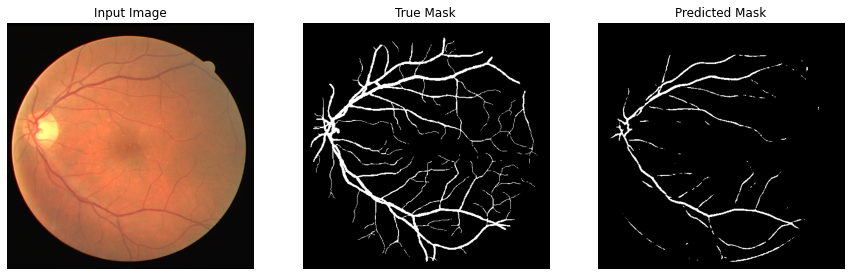


Sample Prediction after epoch 181

Epoch 182/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1662 - accuracy: 0.9761
Epoch 183/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1660 - accuracy: 0.9758
Epoch 184/400
2/2 [==============================] - 1s 405ms/step - loss: 0.1647 - accuracy: 0.9762
Epoch 185/400
2/2 [==============================] - 1s 415ms/step - loss: 0.1639 - accuracy: 0.9762
Epoch 186/400
2/2 [==============================] - 1s 404ms/step - loss: 0.1630 - accuracy: 0.9762


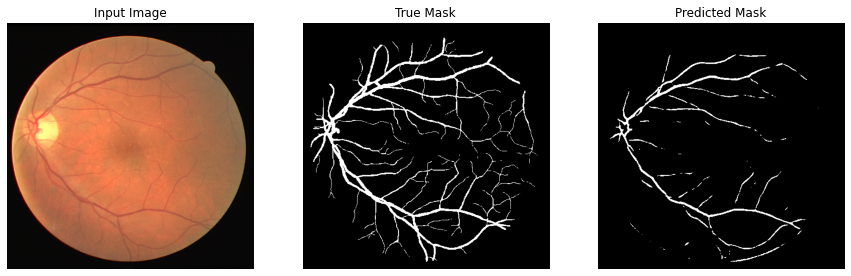


Sample Prediction after epoch 186

Epoch 187/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1622 - accuracy: 0.9762
Epoch 188/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1613 - accuracy: 0.9765
Epoch 189/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1605 - accuracy: 0.9765
Epoch 190/400
2/2 [==============================] - 1s 403ms/step - loss: 0.1593 - accuracy: 0.9767
Epoch 191/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1590 - accuracy: 0.9766


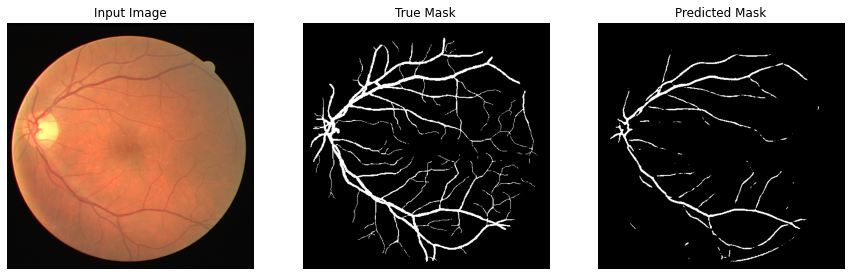


Sample Prediction after epoch 191

Epoch 192/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1578 - accuracy: 0.9768
Epoch 193/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1573 - accuracy: 0.9767
Epoch 194/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1560 - accuracy: 0.9772
Epoch 195/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1556 - accuracy: 0.9769
Epoch 196/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1547 - accuracy: 0.9772


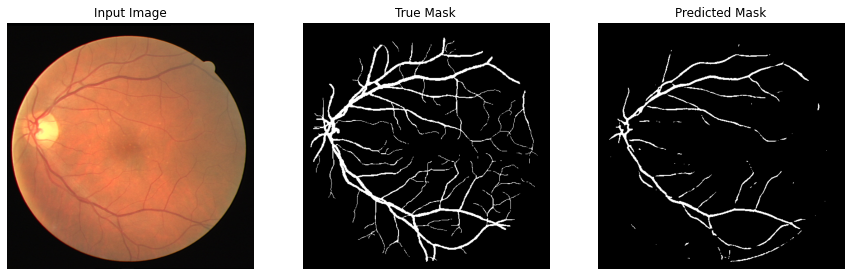


Sample Prediction after epoch 196

Epoch 197/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1547 - accuracy: 0.9765
Epoch 198/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1533 - accuracy: 0.9771
Epoch 199/400
2/2 [==============================] - 1s 421ms/step - loss: 0.1531 - accuracy: 0.9769
Epoch 200/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1511 - accuracy: 0.9777
Epoch 201/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1505 - accuracy: 0.9776


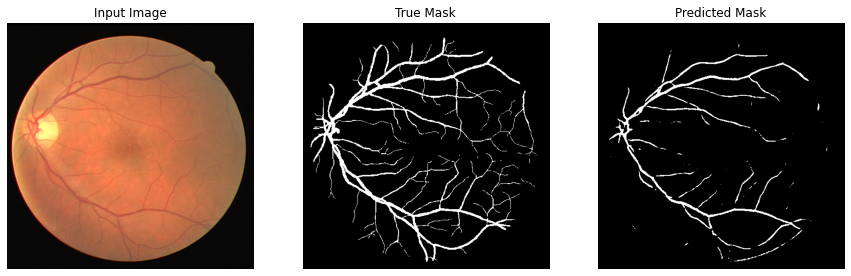


Sample Prediction after epoch 201

Epoch 202/400
2/2 [==============================] - 1s 405ms/step - loss: 0.1494 - accuracy: 0.9779
Epoch 203/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1485 - accuracy: 0.9781
Epoch 204/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1484 - accuracy: 0.9778
Epoch 205/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1473 - accuracy: 0.9780
Epoch 206/400
2/2 [==============================] - 1s 404ms/step - loss: 0.1468 - accuracy: 0.9780


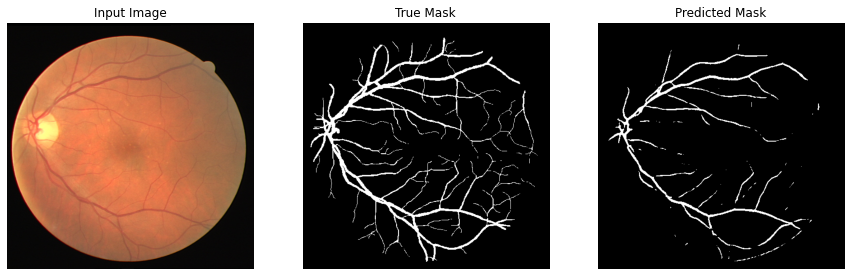


Sample Prediction after epoch 206

Epoch 207/400
2/2 [==============================] - 1s 403ms/step - loss: 0.1467 - accuracy: 0.9776
Epoch 208/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1455 - accuracy: 0.9780
Epoch 209/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1451 - accuracy: 0.9779
Epoch 210/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1437 - accuracy: 0.9783
Epoch 211/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1428 - accuracy: 0.9786


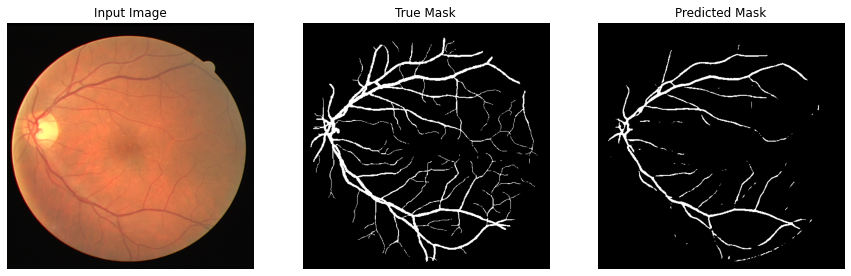


Sample Prediction after epoch 211

Epoch 212/400
2/2 [==============================] - 1s 415ms/step - loss: 0.1431 - accuracy: 0.9781
Epoch 213/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1415 - accuracy: 0.9787
Epoch 214/400
2/2 [==============================] - 1s 406ms/step - loss: 0.1405 - accuracy: 0.9790
Epoch 215/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1396 - accuracy: 0.9792
Epoch 216/400
2/2 [==============================] - 1s 403ms/step - loss: 0.1395 - accuracy: 0.9789


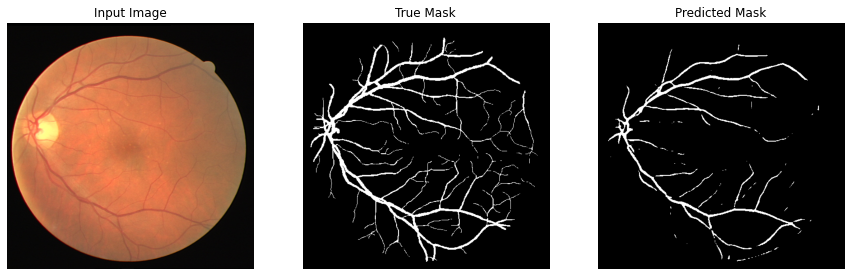


Sample Prediction after epoch 216

Epoch 217/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1386 - accuracy: 0.9791
Epoch 218/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1381 - accuracy: 0.9789
Epoch 219/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1375 - accuracy: 0.9792
Epoch 220/400
2/2 [==============================] - 1s 420ms/step - loss: 0.1370 - accuracy: 0.9790
Epoch 221/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1363 - accuracy: 0.9791


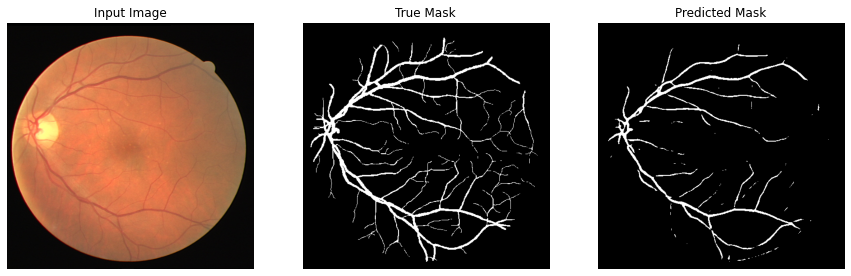


Sample Prediction after epoch 221

Epoch 222/400
2/2 [==============================] - 1s 404ms/step - loss: 0.1353 - accuracy: 0.9795
Epoch 223/400
2/2 [==============================] - 1s 402ms/step - loss: 0.1344 - accuracy: 0.9797
Epoch 224/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1340 - accuracy: 0.9796
Epoch 225/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1343 - accuracy: 0.9790
Epoch 226/400
2/2 [==============================] - 1s 402ms/step - loss: 0.1323 - accuracy: 0.9799


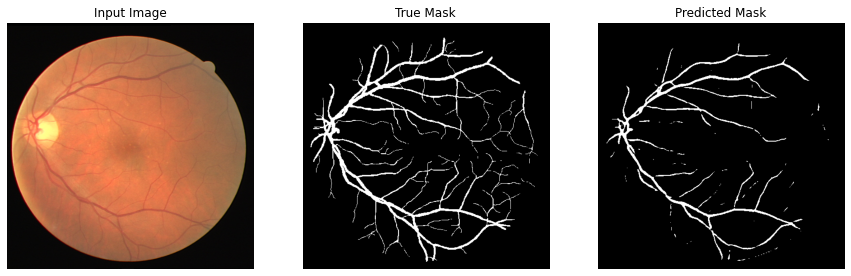


Sample Prediction after epoch 226

Epoch 227/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1321 - accuracy: 0.9797
Epoch 228/400
2/2 [==============================] - 1s 405ms/step - loss: 0.1309 - accuracy: 0.9802
Epoch 229/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1310 - accuracy: 0.9797
Epoch 230/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1298 - accuracy: 0.9803
Epoch 231/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1292 - accuracy: 0.9803


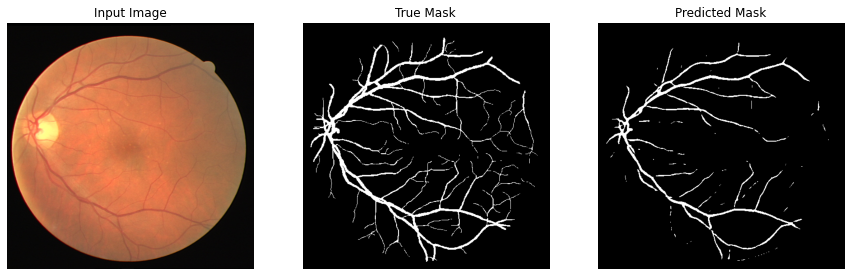


Sample Prediction after epoch 231

Epoch 232/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1298 - accuracy: 0.9796
Epoch 233/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1283 - accuracy: 0.9802
Epoch 234/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1282 - accuracy: 0.9800
Epoch 235/400
2/2 [==============================] - 1s 404ms/step - loss: 0.1271 - accuracy: 0.9804
Epoch 236/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1266 - accuracy: 0.9803


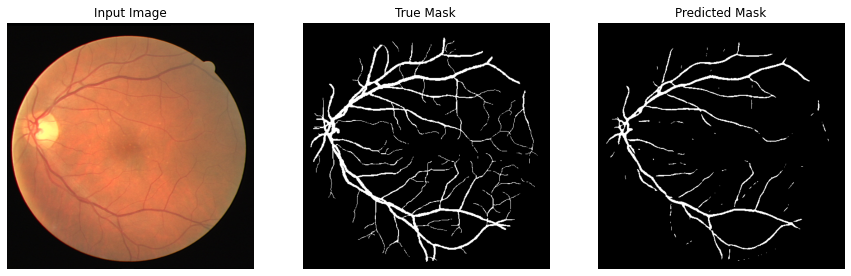


Sample Prediction after epoch 236

Epoch 237/400
2/2 [==============================] - 1s 419ms/step - loss: 0.1258 - accuracy: 0.9805
Epoch 238/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1257 - accuracy: 0.9803
Epoch 239/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1242 - accuracy: 0.9810
Epoch 240/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1250 - accuracy: 0.9803
Epoch 241/400
2/2 [==============================] - 1s 404ms/step - loss: 0.1230 - accuracy: 0.9812


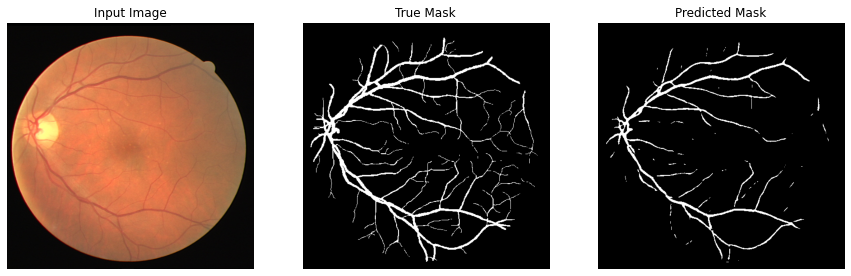


Sample Prediction after epoch 241

Epoch 242/400
2/2 [==============================] - 1s 403ms/step - loss: 0.1236 - accuracy: 0.9804
Epoch 243/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1223 - accuracy: 0.9811
Epoch 244/400
2/2 [==============================] - 1s 422ms/step - loss: 0.1218 - accuracy: 0.9809
Epoch 245/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1210 - accuracy: 0.9813
Epoch 246/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1208 - accuracy: 0.9811


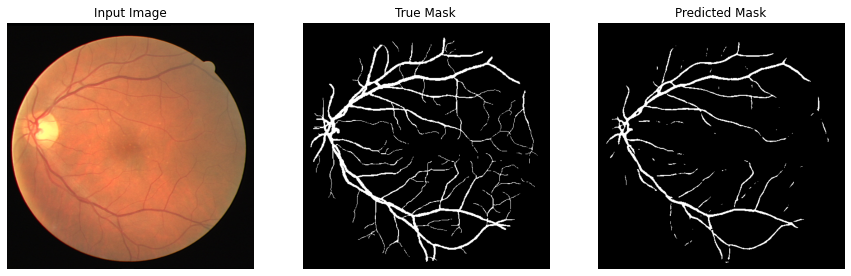


Sample Prediction after epoch 246

Epoch 247/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1198 - accuracy: 0.9814
Epoch 248/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1189 - accuracy: 0.9818
Epoch 249/400
2/2 [==============================] - 1s 419ms/step - loss: 0.1188 - accuracy: 0.9815
Epoch 250/400
2/2 [==============================] - 1s 404ms/step - loss: 0.1185 - accuracy: 0.9813
Epoch 251/400
2/2 [==============================] - 1s 419ms/step - loss: 0.1182 - accuracy: 0.9813


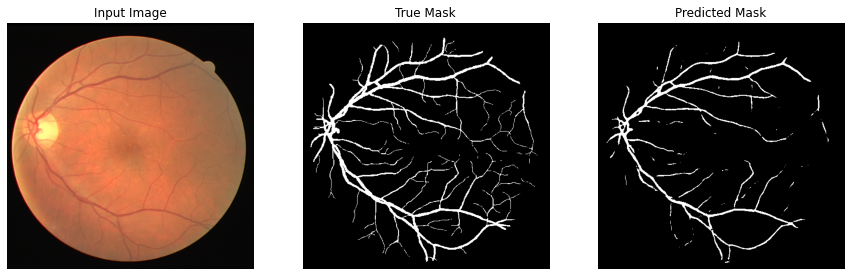


Sample Prediction after epoch 251

Epoch 252/400
2/2 [==============================] - 1s 410ms/step - loss: 0.1180 - accuracy: 0.9811
Epoch 253/400
2/2 [==============================] - 1s 423ms/step - loss: 0.1174 - accuracy: 0.9812
Epoch 254/400
2/2 [==============================] - 1s 421ms/step - loss: 0.1168 - accuracy: 0.9812
Epoch 255/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1157 - accuracy: 0.9818
Epoch 256/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1155 - accuracy: 0.9817


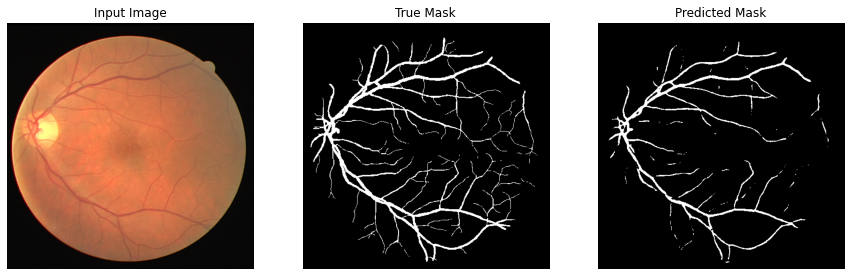


Sample Prediction after epoch 256

Epoch 257/400
2/2 [==============================] - 1s 420ms/step - loss: 0.1147 - accuracy: 0.9819
Epoch 258/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1154 - accuracy: 0.9811
Epoch 259/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1149 - accuracy: 0.9813
Epoch 260/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1140 - accuracy: 0.9815
Epoch 261/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1134 - accuracy: 0.9816


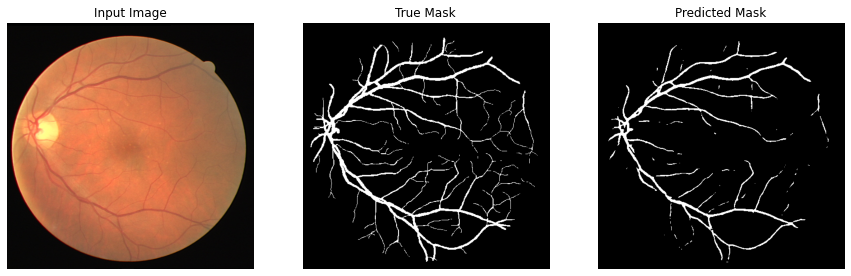


Sample Prediction after epoch 261

Epoch 262/400
2/2 [==============================] - 1s 419ms/step - loss: 0.1125 - accuracy: 0.9820
Epoch 263/400
2/2 [==============================] - 1s 419ms/step - loss: 0.1124 - accuracy: 0.9817
Epoch 264/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1116 - accuracy: 0.9820
Epoch 265/400
2/2 [==============================] - 1s 419ms/step - loss: 0.1108 - accuracy: 0.9824
Epoch 266/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1109 - accuracy: 0.9820


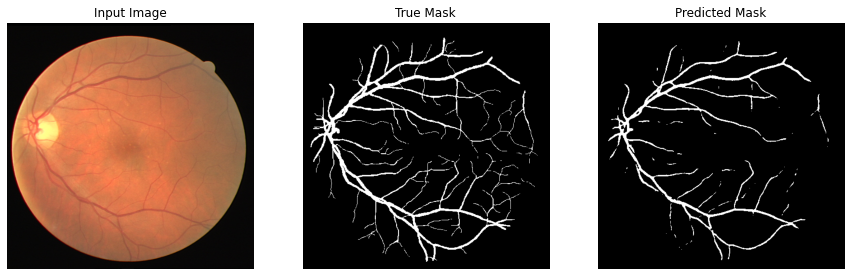


Sample Prediction after epoch 266

Epoch 267/400
2/2 [==============================] - 1s 406ms/step - loss: 0.1106 - accuracy: 0.9819
Epoch 268/400
2/2 [==============================] - 1s 420ms/step - loss: 0.1097 - accuracy: 0.9823
Epoch 269/400
2/2 [==============================] - 1s 406ms/step - loss: 0.1091 - accuracy: 0.9825
Epoch 270/400
2/2 [==============================] - 1s 419ms/step - loss: 0.1087 - accuracy: 0.9825
Epoch 271/400
2/2 [==============================] - 1s 419ms/step - loss: 0.1082 - accuracy: 0.9827


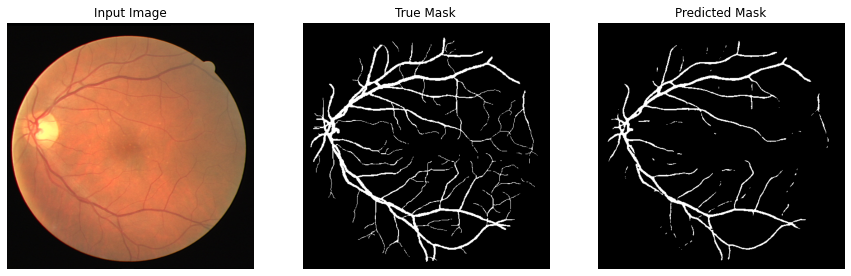


Sample Prediction after epoch 271

Epoch 272/400
2/2 [==============================] - 1s 406ms/step - loss: 0.1076 - accuracy: 0.9827
Epoch 273/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1071 - accuracy: 0.9829
Epoch 274/400
2/2 [==============================] - 1s 419ms/step - loss: 0.1073 - accuracy: 0.9824
Epoch 275/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1068 - accuracy: 0.9826
Epoch 276/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1057 - accuracy: 0.9830


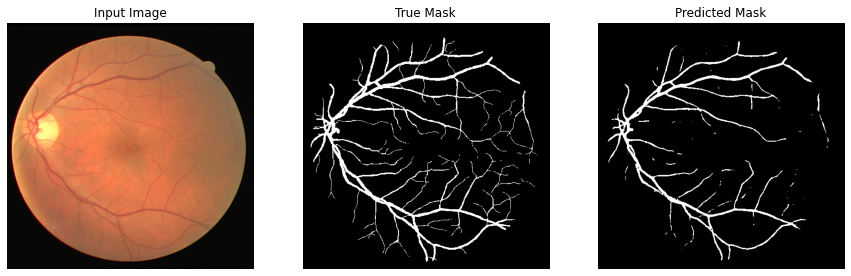


Sample Prediction after epoch 276

Epoch 277/400
2/2 [==============================] - 1s 403ms/step - loss: 0.1054 - accuracy: 0.9830
Epoch 278/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1052 - accuracy: 0.9829
Epoch 279/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1039 - accuracy: 0.9836
Epoch 280/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1040 - accuracy: 0.9833
Epoch 281/400
2/2 [==============================] - 1s 419ms/step - loss: 0.1037 - accuracy: 0.9831


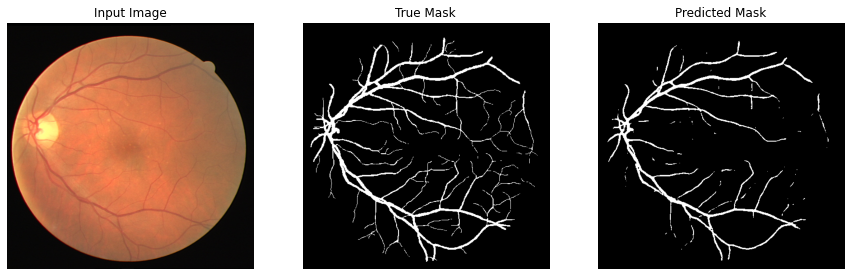


Sample Prediction after epoch 281

Epoch 282/400
2/2 [==============================] - 1s 420ms/step - loss: 0.1028 - accuracy: 0.9835
Epoch 283/400
2/2 [==============================] - 1s 415ms/step - loss: 0.1031 - accuracy: 0.9831
Epoch 284/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1022 - accuracy: 0.9835
Epoch 285/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1014 - accuracy: 0.9839
Epoch 286/400
2/2 [==============================] - 1s 419ms/step - loss: 0.1010 - accuracy: 0.9839


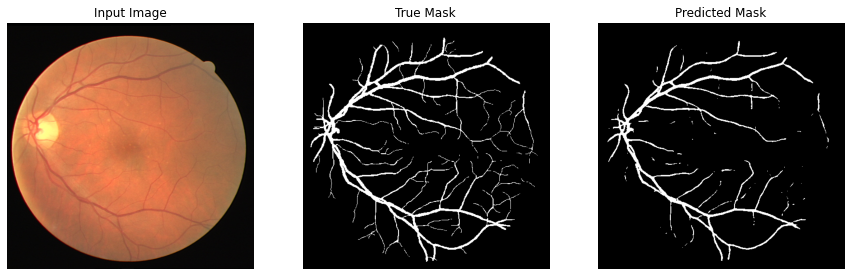


Sample Prediction after epoch 286

Epoch 287/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1025 - accuracy: 0.9826
Epoch 288/400
2/2 [==============================] - 1s 404ms/step - loss: 0.1007 - accuracy: 0.9835
Epoch 289/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1001 - accuracy: 0.9838
Epoch 290/400
2/2 [==============================] - 1s 404ms/step - loss: 0.1004 - accuracy: 0.9832
Epoch 291/400
2/2 [==============================] - 1s 419ms/step - loss: 0.0999 - accuracy: 0.9833


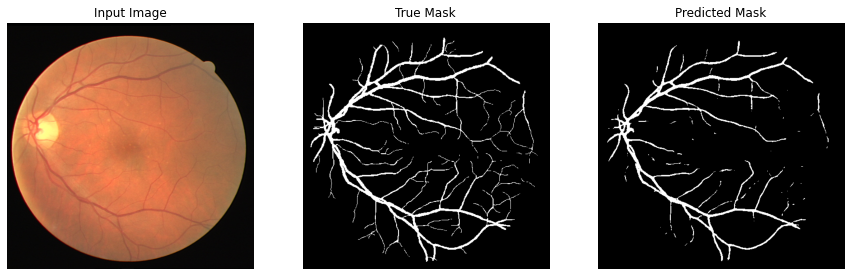


Sample Prediction after epoch 291

Epoch 292/400
2/2 [==============================] - 1s 421ms/step - loss: 0.1000 - accuracy: 0.9830
Epoch 293/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1001 - accuracy: 0.9828
Epoch 294/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0984 - accuracy: 0.9838
Epoch 295/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0976 - accuracy: 0.9842
Epoch 296/400
2/2 [==============================] - 1s 420ms/step - loss: 0.0980 - accuracy: 0.9836


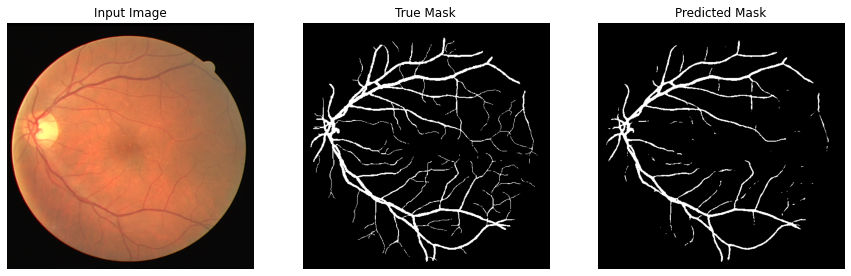


Sample Prediction after epoch 296

Epoch 297/400
2/2 [==============================] - 1s 419ms/step - loss: 0.0970 - accuracy: 0.9840
Epoch 298/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0969 - accuracy: 0.9839
Epoch 299/400
2/2 [==============================] - 1s 405ms/step - loss: 0.0967 - accuracy: 0.9839
Epoch 300/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0972 - accuracy: 0.9834
Epoch 301/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0960 - accuracy: 0.9839


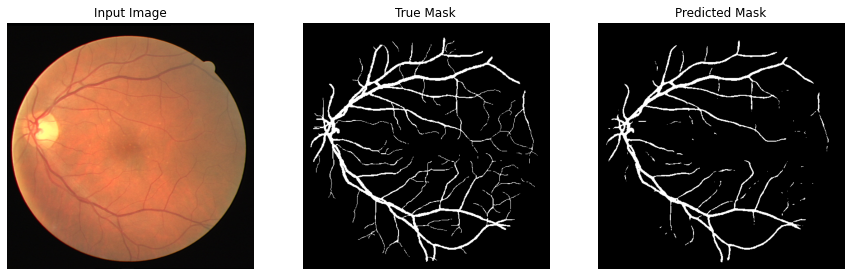


Sample Prediction after epoch 301

Epoch 302/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0955 - accuracy: 0.9840
Epoch 303/400
2/2 [==============================] - 1s 421ms/step - loss: 0.0951 - accuracy: 0.9841
Epoch 304/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0954 - accuracy: 0.9838
Epoch 305/400
2/2 [==============================] - 1s 405ms/step - loss: 0.0942 - accuracy: 0.9844
Epoch 306/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0935 - accuracy: 0.9847


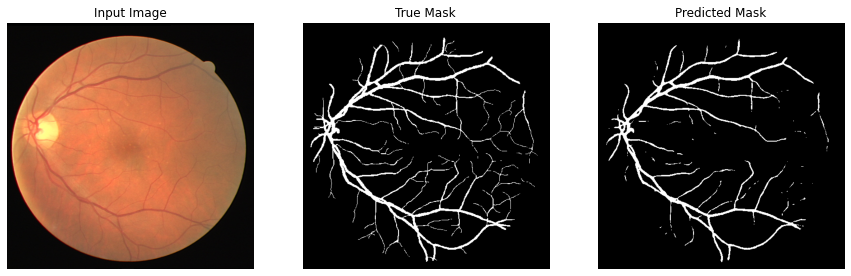


Sample Prediction after epoch 306

Epoch 307/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0930 - accuracy: 0.9848
Epoch 308/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0933 - accuracy: 0.9843
Epoch 309/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0926 - accuracy: 0.9846
Epoch 310/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0916 - accuracy: 0.9852
Epoch 311/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0926 - accuracy: 0.9843


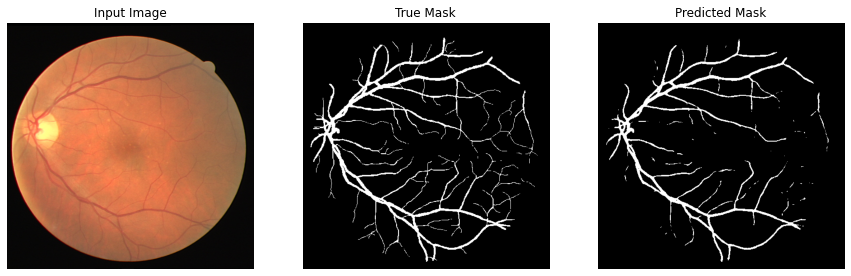


Sample Prediction after epoch 311

Epoch 312/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0916 - accuracy: 0.9847
Epoch 313/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0909 - accuracy: 0.9850
Epoch 314/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0908 - accuracy: 0.9849
Epoch 315/400
2/2 [==============================] - 1s 405ms/step - loss: 0.0901 - accuracy: 0.9852
Epoch 316/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0896 - accuracy: 0.9853


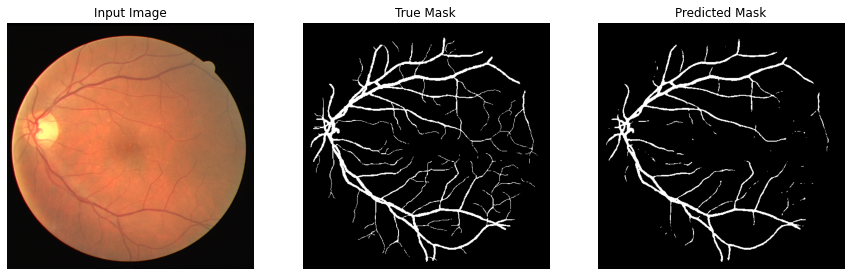


Sample Prediction after epoch 316

Epoch 317/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0892 - accuracy: 0.9855
Epoch 318/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0891 - accuracy: 0.9853
Epoch 319/400
2/2 [==============================] - 1s 405ms/step - loss: 0.0895 - accuracy: 0.9848
Epoch 320/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0895 - accuracy: 0.9847
Epoch 321/400
2/2 [==============================] - 1s 419ms/step - loss: 0.0887 - accuracy: 0.9850


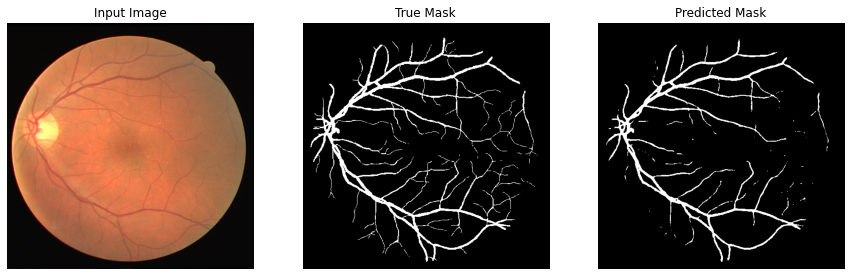


Sample Prediction after epoch 321

Epoch 322/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0890 - accuracy: 0.9846
Epoch 323/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0875 - accuracy: 0.9855
Epoch 324/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0875 - accuracy: 0.9854
Epoch 325/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0866 - accuracy: 0.9858
Epoch 326/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0865 - accuracy: 0.9856


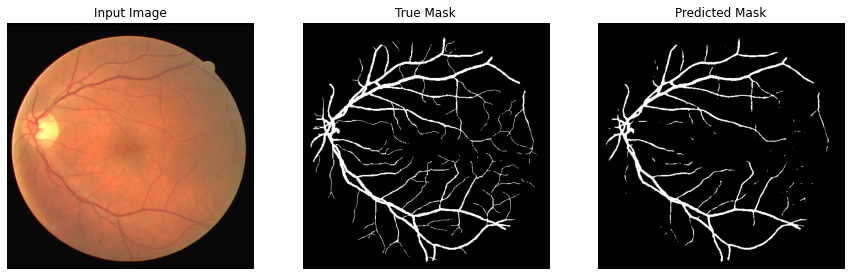


Sample Prediction after epoch 326

Epoch 327/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0877 - accuracy: 0.9847
Epoch 328/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0858 - accuracy: 0.9857
Epoch 329/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0869 - accuracy: 0.9848
Epoch 330/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0856 - accuracy: 0.9855
Epoch 331/400
2/2 [==============================] - 1s 419ms/step - loss: 0.0850 - accuracy: 0.9858


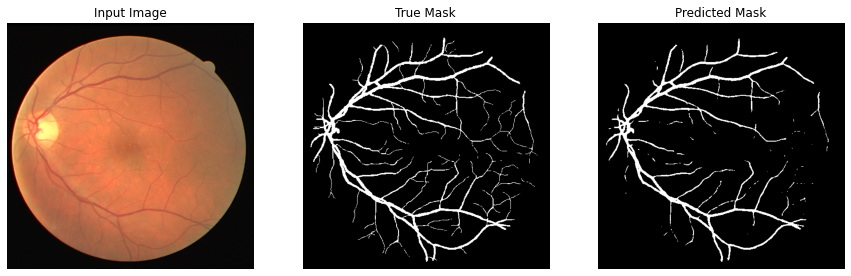


Sample Prediction after epoch 331

Epoch 332/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0859 - accuracy: 0.9850
Epoch 333/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0843 - accuracy: 0.9861
Epoch 334/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0838 - accuracy: 0.9861
Epoch 335/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0843 - accuracy: 0.9855
Epoch 336/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0834 - accuracy: 0.9861


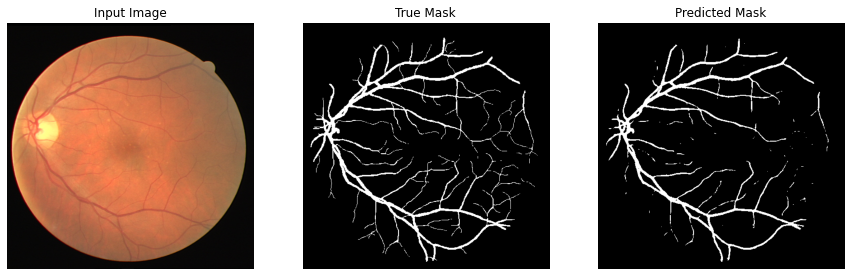


Sample Prediction after epoch 336

Epoch 337/400
2/2 [==============================] - 1s 419ms/step - loss: 0.0836 - accuracy: 0.9857
Epoch 338/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0834 - accuracy: 0.9858
Epoch 339/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0826 - accuracy: 0.9862
Epoch 340/400
2/2 [==============================] - 1s 420ms/step - loss: 0.0820 - accuracy: 0.9864
Epoch 341/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0826 - accuracy: 0.9858


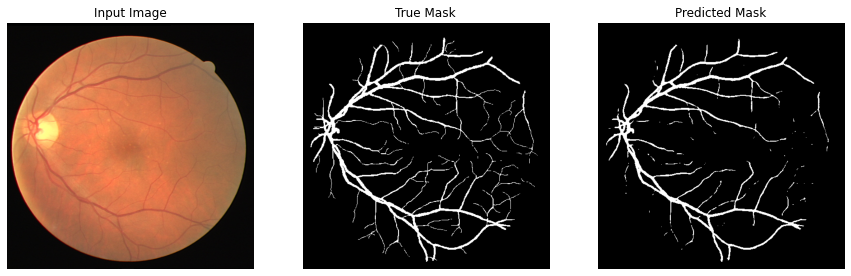


Sample Prediction after epoch 341

Epoch 342/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0819 - accuracy: 0.9862
Epoch 343/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0815 - accuracy: 0.9862
Epoch 344/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0809 - accuracy: 0.9866
Epoch 345/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0813 - accuracy: 0.9861
Epoch 346/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0803 - accuracy: 0.9866


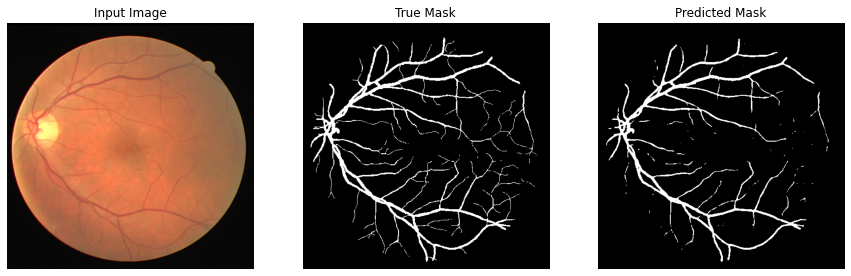


Sample Prediction after epoch 346

Epoch 347/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0798 - accuracy: 0.9868
Epoch 348/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0798 - accuracy: 0.9867
Epoch 349/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0800 - accuracy: 0.9863
Epoch 350/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0795 - accuracy: 0.9866
Epoch 351/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0815 - accuracy: 0.9848


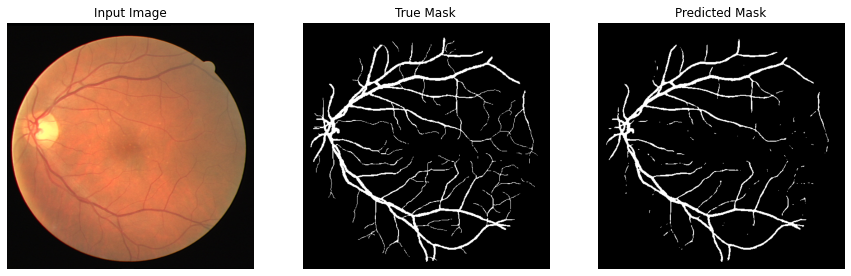


Sample Prediction after epoch 351

Epoch 352/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0798 - accuracy: 0.9858
Epoch 353/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0794 - accuracy: 0.9861
Epoch 354/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0789 - accuracy: 0.9862
Epoch 355/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0783 - accuracy: 0.9865
Epoch 356/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0783 - accuracy: 0.9864


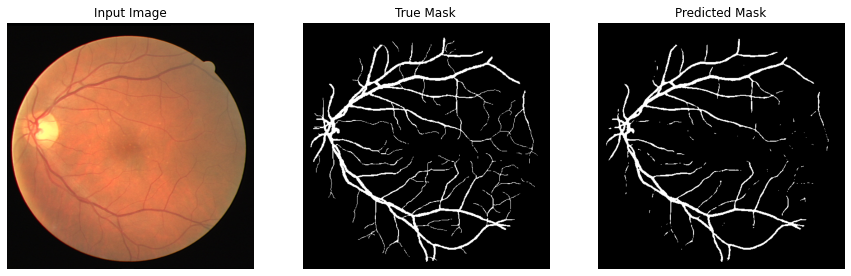


Sample Prediction after epoch 356

Epoch 357/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0776 - accuracy: 0.9868
Epoch 358/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0769 - accuracy: 0.9871
Epoch 359/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0771 - accuracy: 0.9868
Epoch 360/400
2/2 [==============================] - 1s 408ms/step - loss: 0.0772 - accuracy: 0.9867
Epoch 361/400
2/2 [==============================] - 1s 419ms/step - loss: 0.0765 - accuracy: 0.9869


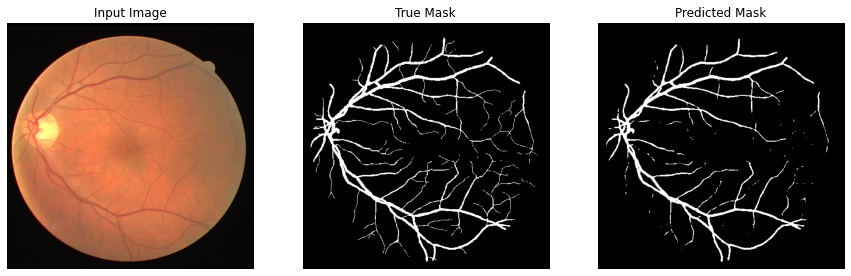


Sample Prediction after epoch 361

Epoch 362/400
2/2 [==============================] - 1s 420ms/step - loss: 0.0767 - accuracy: 0.9867
Epoch 363/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0756 - accuracy: 0.9874
Epoch 364/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0757 - accuracy: 0.9870
Epoch 365/400
2/2 [==============================] - 1s 402ms/step - loss: 0.0760 - accuracy: 0.9868
Epoch 366/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0749 - accuracy: 0.9874


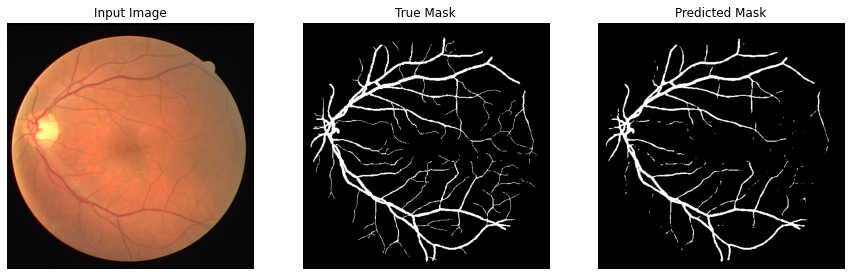


Sample Prediction after epoch 366

Epoch 367/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0749 - accuracy: 0.9874
Epoch 368/400
2/2 [==============================] - 1s 420ms/step - loss: 0.0748 - accuracy: 0.9873
Epoch 369/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0745 - accuracy: 0.9873
Epoch 370/400
2/2 [==============================] - 1s 404ms/step - loss: 0.0737 - accuracy: 0.9878
Epoch 371/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0740 - accuracy: 0.9873


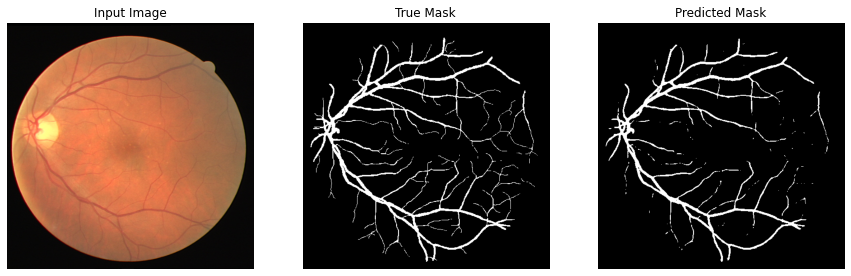


Sample Prediction after epoch 371

Epoch 372/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0739 - accuracy: 0.9873
Epoch 373/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0734 - accuracy: 0.9875
Epoch 374/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0744 - accuracy: 0.9867
Epoch 375/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0733 - accuracy: 0.9873
Epoch 376/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0728 - accuracy: 0.9875


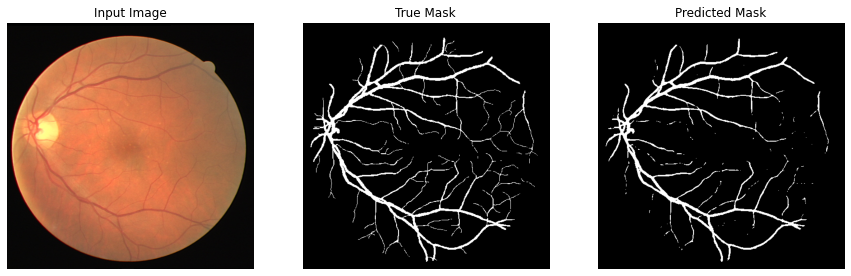


Sample Prediction after epoch 376

Epoch 377/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0734 - accuracy: 0.9870
Epoch 378/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0724 - accuracy: 0.9874
Epoch 379/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0718 - accuracy: 0.9878
Epoch 380/400
2/2 [==============================] - 1s 419ms/step - loss: 0.0717 - accuracy: 0.9877
Epoch 381/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0718 - accuracy: 0.9876


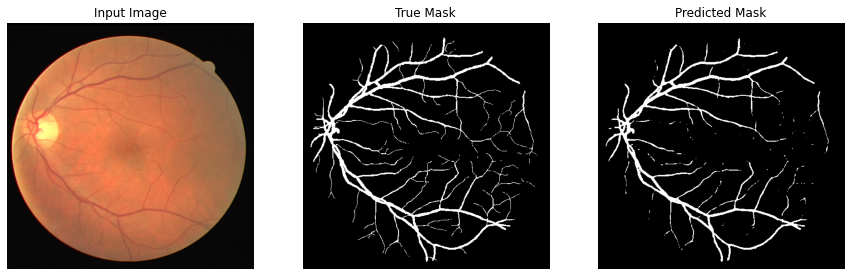


Sample Prediction after epoch 381

Epoch 382/400
2/2 [==============================] - 1s 404ms/step - loss: 0.0713 - accuracy: 0.9877
Epoch 383/400
2/2 [==============================] - 1s 404ms/step - loss: 0.0710 - accuracy: 0.9879
Epoch 384/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0715 - accuracy: 0.9873
Epoch 385/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0712 - accuracy: 0.9875
Epoch 386/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0704 - accuracy: 0.9879


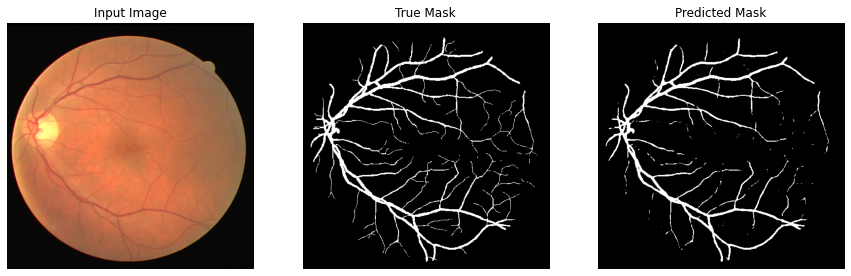


Sample Prediction after epoch 386

Epoch 387/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0696 - accuracy: 0.9883
Epoch 388/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0697 - accuracy: 0.9882
Epoch 389/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0698 - accuracy: 0.9879
Epoch 390/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0706 - accuracy: 0.9873
Epoch 391/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0698 - accuracy: 0.9875


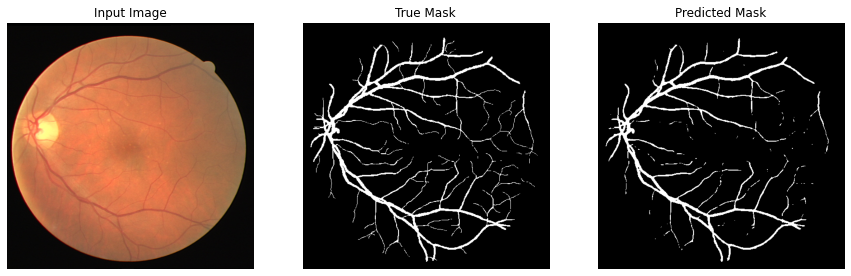


Sample Prediction after epoch 391

Epoch 392/400
2/2 [==============================] - 1s 405ms/step - loss: 0.0689 - accuracy: 0.9882
Epoch 393/400
2/2 [==============================] - 1s 419ms/step - loss: 0.0696 - accuracy: 0.9876
Epoch 394/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0688 - accuracy: 0.9881
Epoch 395/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0687 - accuracy: 0.9879
Epoch 396/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0685 - accuracy: 0.9881


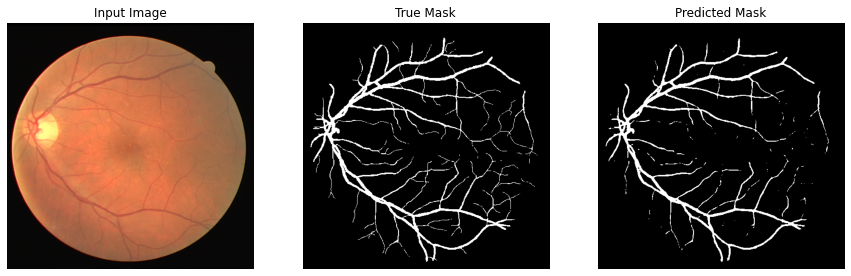


Sample Prediction after epoch 396

Epoch 397/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0677 - accuracy: 0.9885
Epoch 398/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0680 - accuracy: 0.9881
Epoch 399/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0676 - accuracy: 0.9883
Epoch 400/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0672 - accuracy: 0.9886


In [8]:
# define optomizer
optim = keras.optimizers.Adam(0.0001) # learning rate = 0.0001
bce   = keras.losses.BinaryCrossentropy() # binary cross-entropy loss function
metrics = ["accuracy"]

# compile keras model with defined optimozer, loss and metrics
model.compile(optim, bce, metrics)

model.fit(
    train_dataset, 
    callbacks=[DisplayCallback(train_dataset)],
    epochs=400
)

# Output before One-shot

Number of samples for testing: 11 11
11/11 [==============================] - 2s 31ms/step - loss: 0.1574 - accuracy: 0.9478
Test Loss: 0.15741361677646637
Test Accuracy: 0.9477614760398865


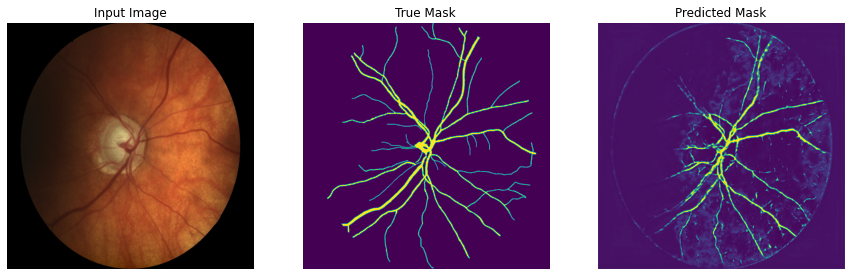

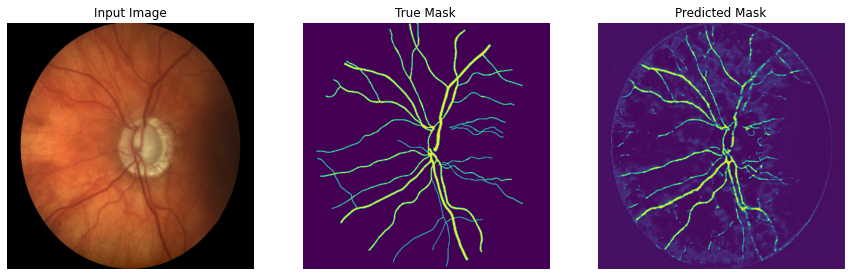

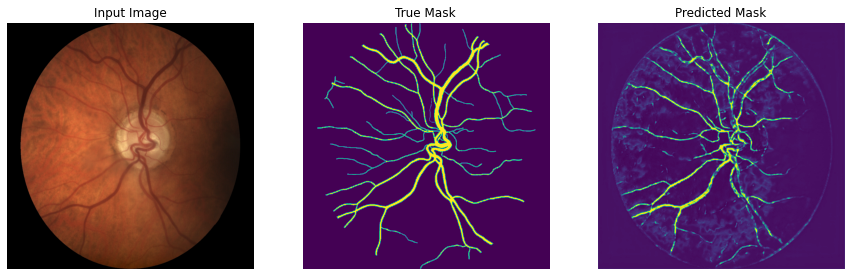

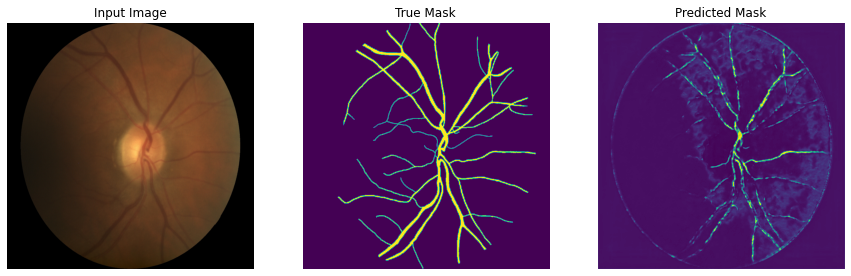

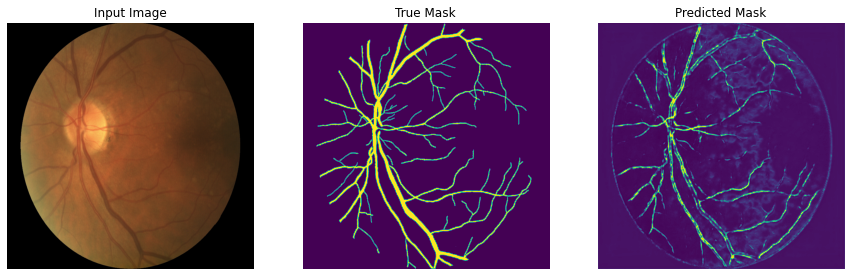

...

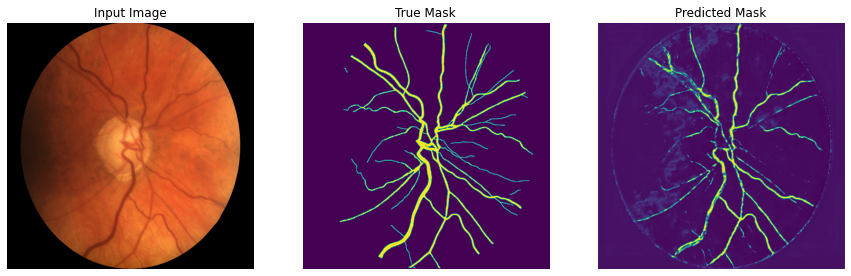

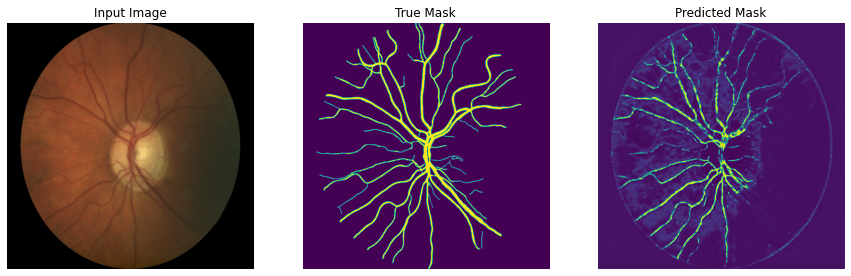

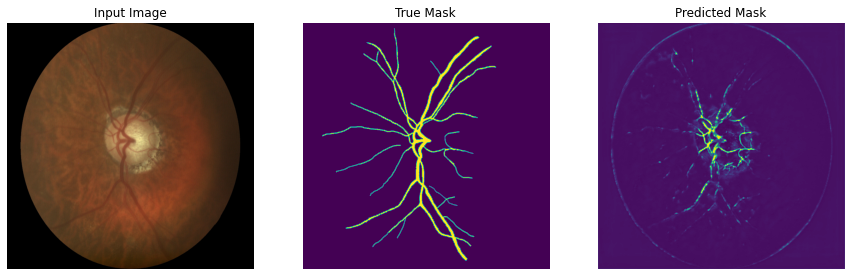

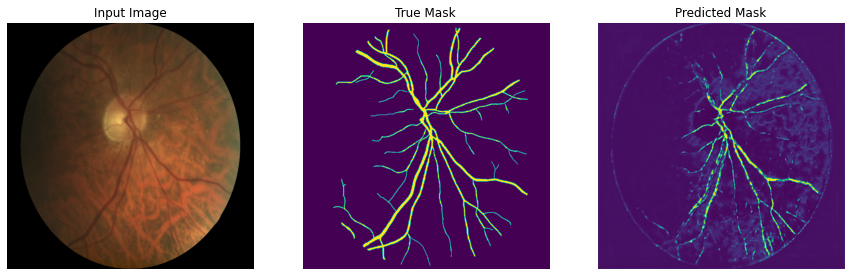

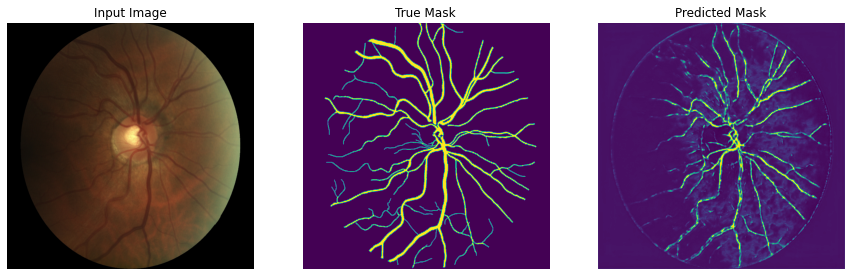

In [12]:
images_path = '/kaggle/input/les-av-dataset/les-av-dataset/images'
masks_path = '/kaggle/input/les-av-dataset/les-av-dataset/masks'

# Fetch 11 images and masks
exts = ('jpg', 'JPG', 'png', 'PNG', 'tif', 'gif', 'ppm')
les_images = sorted(
    [os.path.join(images_path, fname) for fname in os.listdir(images_path) if fname.endswith(exts)]
)[:11]
les_masks = sorted(
    [os.path.join(masks_path, fname) for fname in os.listdir(masks_path) if fname.endswith(exts)]
)[:11]

print("Number of samples for testing:", len(les_images), len(les_masks))

def load_image_mask_pair(image_path, mask_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_png(image, channels=3)
    image = tf.image.resize(image, [768, 768]) / 255.0  
    
    mask = tf.io.read_file(mask_path)
    mask = tf.image.decode_png(mask, channels=1)
    mask = tf.image.resize(mask, [768, 768]) / 255.0  
    return image, mask

test_dataset = tf.data.Dataset.from_tensor_slices((les_images, les_masks)).map(load_image_mask_pair).batch(1)

class DisplayCallback(tf.keras.callbacks.Callback):
    def __init__(self, model, test_data, num_samples=11):
        super().__init__()
        self.model = model
        self.test_data = test_data.take(num_samples)  # Limit to 11 samples for display

    def on_epoch_end(self, epoch, logs=None):
        for image, mask in self.test_data:
            # Predict the mask for each test image
            pred_mask = self.model.predict(image)  
            display([image[0], mask[0], pred_mask[0]])  # Show the input, ground truth, and predicted mask

def display(display_list):
    import matplotlib.pyplot as plt

    plt.figure(figsize=(15, 5))
    titles = ["Input Image", "True Mask", "Predicted Mask"]

    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(titles[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis("off")
    plt.show()

display_callback = DisplayCallback(model=model, test_data=test_dataset, num_samples=11)

test_loss, test_accuracy = model.evaluate(test_dataset)
print(f"Test Loss: {test_loss}")
print(f"Test Accuracy: {test_accuracy}")

# show predictions for all 11 test images
display_callback.on_epoch_end(epoch=1)  # `epoch=1` is a placeholder



# Performing One-shot training

In [15]:
import tensorflow as tf
import os
import numpy as np
from sklearn.model_selection import train_test_split

images_path = '/kaggle/input/les-av-dataset/les-av-dataset/images'  
masks_path = '/kaggle/input/les-av-dataset/les-av-dataset/masks'   

all_images = sorted([os.path.join(images_path, f) for f in os.listdir(images_path) if f.endswith(('jpg', 'png', 'tif'))])
all_masks = sorted([os.path.join(masks_path, f) for f in os.listdir(masks_path) if f.endswith(('jpg', 'png', 'tif'))])

# Spliting the dataset into 1 train, 10 validation, and 11 test
train_images, val_test_images, train_masks, val_test_masks = train_test_split(
    all_images, all_masks, test_size=21, random_state=42
)
val_images, test_images, val_masks, test_masks = train_test_split(
    val_test_images, val_test_masks, test_size=11, random_state=42
)

def load_image_mask_pair(image_path, mask_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_png(image, channels=3)
    image = tf.image.resize(image, [768, 768]) / 255.0  
    
    mask = tf.io.read_file(mask_path)
    mask = tf.image.decode_png(mask, channels=1)
    mask = tf.image.resize(mask, [768, 768]) / 255.0  
    return image, mask

train_dataset = tf.data.Dataset.from_tensor_slices((train_images, train_masks)).map(load_image_mask_pair).batch(1)
val_dataset = tf.data.Dataset.from_tensor_slices((val_images, val_masks)).map(load_image_mask_pair).batch(1)
test_dataset = tf.data.Dataset.from_tensor_slices((test_images, test_masks)).map(load_image_mask_pair).batch(1)

# Training the existing model on the single training image for one-shot learning
history = model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=20
)

# Save the model
model_save_path = '/kaggle/working/les_av_trained_model'
model.save(model_save_path)
print(f"Model saved to {model_save_path}")


Epoch 1/20
1/1 [==============================] - 1s 720ms/step - loss: 0.0457 - accuracy: 0.9821 - val_loss: 0.1269 - val_accuracy: 0.9568
Epoch 2/20
1/1 [==============================] - 1s 680ms/step - loss: 0.0454 - accuracy: 0.9821 - val_loss: 0.1268 - val_accuracy: 0.9568
Epoch 3/20
1/1 [==============================] - 1s 684ms/step - loss: 0.0454 - accuracy: 0.9821 - val_loss: 0.1272 - val_accuracy: 0.9567
Epoch 4/20
1/1 [==============================] - 1s 669ms/step - loss: 0.0454 - accuracy: 0.9821 - val_loss: 0.1277 - val_accuracy: 0.9565
Epoch 5/20
1/1 [==============================] - 1s 764ms/step - loss: 0.0452 - accuracy: 0.9822 - val_loss: 0.1281 - val_accuracy: 0.9564
Epoch 6/20
1/1 [==============================] - 1s 790ms/step - loss: 0.0452 - accuracy: 0.9821 - val_loss: 0.1281 - val_accuracy: 0.9563
Epoch 7/20
1/1 [==============================] - 1s 694ms/step - loss: 0.0450 - accuracy: 0.9822 - val_loss: 0.1279 - val_accuracy: 0.9564
Epoch 8/20
1/1 [====

/opt/conda/lib/python3.7/site-packages/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


Model saved to /kaggle/working/les_av_trained_model


11/11 [==============================] - 1s 33ms/step - loss: 0.1193 - accuracy: 0.9585
Test Loss: 0.11933737248182297
Test Accuracy: 0.9584639072418213


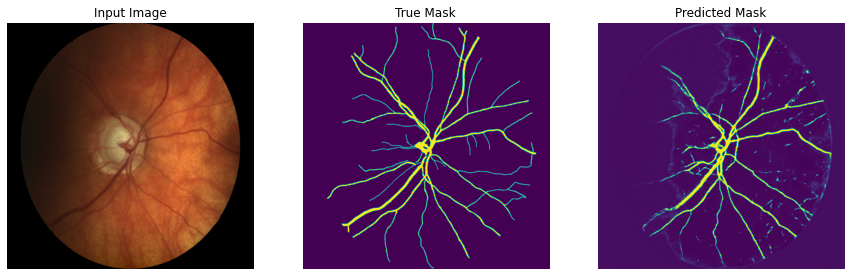

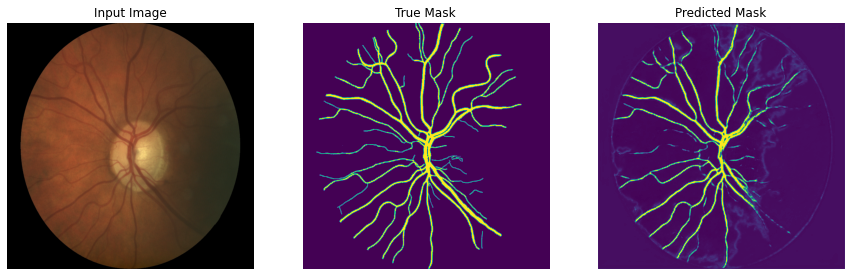

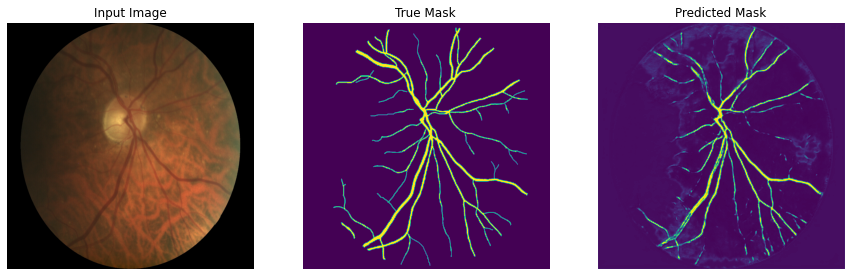

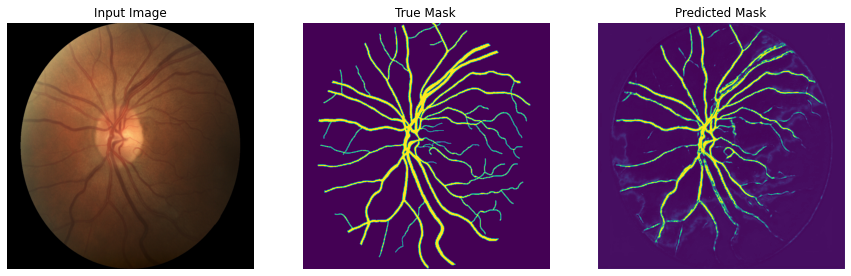

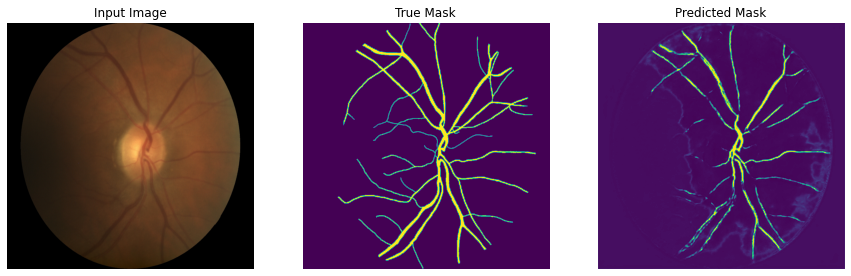

...

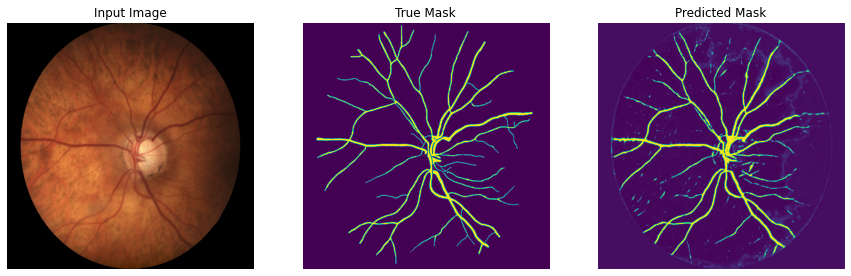

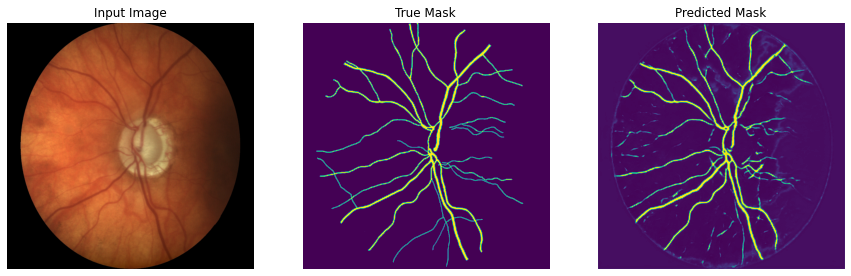

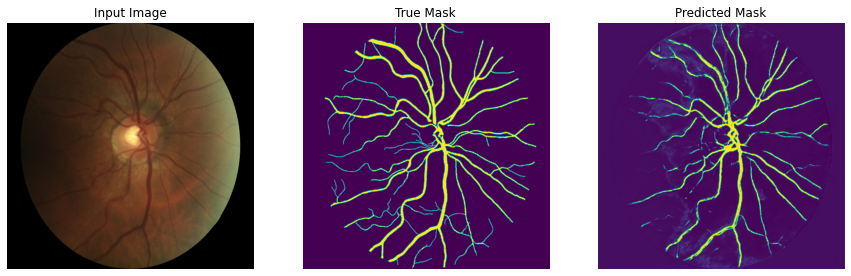

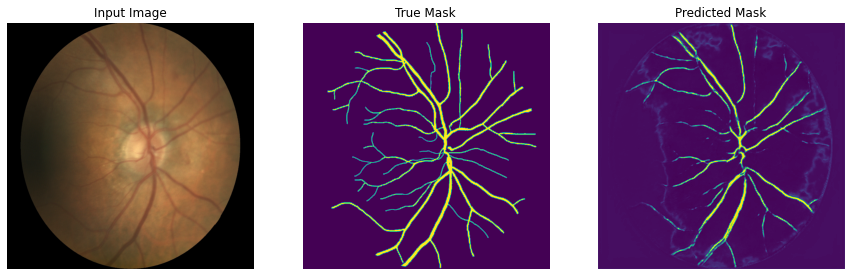

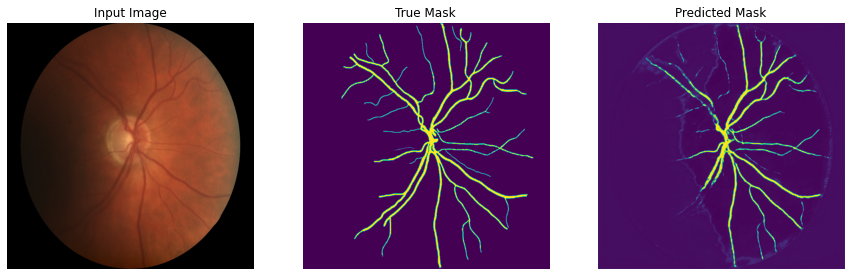

In [16]:
class DisplayCallback(tf.keras.callbacks.Callback):
    def __init__(self, model, test_data, num_samples=11):
        super().__init__()
        self.model = model
        self.test_data = test_data.take(num_samples)  # Limit to 11 samples for display

    def on_epoch_end(self, epoch, logs=None):
        for image, mask in self.test_data:
            # Predict the mask for each test image
            pred_mask = self.model.predict(image)  
            display([image[0], mask[0], pred_mask[0]])  # Show the input, ground truth, and predicted mask

def display(display_list):
    import matplotlib.pyplot as plt

    plt.figure(figsize=(15, 5))
    titles = ["Input Image", "True Mask", "Predicted Mask"]

    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(titles[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis("off")
    plt.show()

display_callback = DisplayCallback(model=model, test_data=test_dataset, num_samples=11)

test_loss, test_accuracy = model.evaluate(test_dataset)
print(f"Test Loss: {test_loss}")
print(f"Test Accuracy: {test_accuracy}")

# show predictions for all 11 test images
display_callback.on_epoch_end(epoch=1)  # `epoch=1` is a placeholder
